<a href="https://colab.research.google.com/github/tanishajn12/NNDL-Labs/blob/main/yolov8_dropcap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install ultralytics
from ultralytics import YOLO

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 26.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 72.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 53.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 19.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

In [2]:
%cd

/root


In [3]:
%cd /content/

/content


In [4]:
import zipfile

zip_path = "/content/dropcap_300.zip"
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall("/content/")

In [5]:
from ultralytics import YOLO

model = YOLO('yolov8s.pt')  # or yolov8s.pt, yolov8m.pt etc.

100%|██████████| 21.5M/21.5M [00:00<00:00, 317MB/s]



```
model.train(
    data='/content/dropcap00/data.yaml',
    epochs=100,              # More epochs since data is small
    imgsz=640,
    batch=2,                 # Small batch to prevent overfitting and fit into memory
    name='dropcap-yolov8n',
    project='dropcap-runs',
    cache=True,
    augment=True,            # Enables built-in augmentations (mosaic, flip, HSV, scale)
    degrees=10,              # Random rotation
    flipud=0.5,              # Vertical flip
    fliplr=0.5,              # Horizontal flip
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    mosaic=1.0,
    mixup=0.2,
    patience=20              # Stop early if no improvement
)
```



In [6]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


In [7]:
model.train(
    data='/content/dropcap_300/data.yaml',
    epochs=100,
    imgsz=640,
    batch=2,
    name='dropcap-yolov8n',
    project='dropcap-runs',
    augment=True,
    degrees=5,
    translate=0.1,
    scale=0.5,
    shear=2,
    perspective=0.0005,
    flipud=0.5,
    fliplr=0.5,
    mosaic=1.0,
    mixup=0.1,
    cache=True,
    patience=10,
    lr0=0.0005
)


Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=2, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dropcap_300/data.yaml, degrees=5, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.5, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0005, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=dropcap-yolov8n, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=10, perspective=0.0005, plots=True, pose=12.0

100%|██████████| 755k/755k [00:00<00:00, 82.1MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

 22        [15, 18, 21]  1   2116435  ultralytics.nn.modules.head.Detect           [1, [128, 256, 512]]          
Model summary: 129 layers, 11,135,987 parameters, 11,135,971 gradients, 28.6 GFLOPs

Transferred 349/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 334MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1025.5±795.3 MB/s, size: 67.6 KB)


train: Scanning /content/dropcap_300/train/labels... 202 images, 0 backgrounds, 0 corrupt: 100%|██████████| 202/202 [00:00<00:00, 2496.29it/s]

train: New cache created: /content/dropcap_300/train/labels.cache
WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.



train: Caching images (0.2GB RAM): 100%|██████████| 202/202 [00:00<00:00, 360.47it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 639.1±281.4 MB/s, size: 67.9 KB)


val: Scanning /content/dropcap_300/valid/labels... 29 images, 0 backgrounds, 0 corrupt: 100%|██████████| 29/29 [00:00<00:00, 1025.30it/s]

val: New cache created: /content/dropcap_300/valid/labels.cache


WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (0.0GB RAM): 100%|██████████| 29/29 [00:00<00:00, 189.46it/s]


Plotting labels to dropcap-runs/dropcap-yolov8n/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to dropcap-runs/dropcap-yolov8n
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100     0.703G      2.021      4.778      1.606          3        640: 100%|██████████| 101/101 [00:11<00:00,  9.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.54it/s]

                   all         29         37      0.427      0.351      0.255      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100     0.836G       1.81      3.025       1.46         10        640: 100%|██████████| 101/101 [00:09<00:00, 10.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.19it/s]

                   all         29         37     0.0187      0.405       0.02    0.00903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100     0.873G      1.869      2.641      1.545          2        640: 100%|██████████| 101/101 [00:08<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 20.82it/s]

                   all         29         37      0.711      0.266      0.377      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      0.91G      1.857       2.56      1.512          4        640: 100%|██████████| 101/101 [00:09<00:00, 11.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.43it/s]

                   all         29         37      0.624      0.676      0.629      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100     0.986G      1.861      2.394       1.59          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 20.81it/s]

                   all         29         37      0.616      0.521      0.567      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.02G      1.899      2.241      1.679          6        640: 100%|██████████| 101/101 [00:09<00:00, 10.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.54it/s]

                   all         29         37      0.721      0.698      0.745      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.08G      1.784      1.956      1.548          6        640: 100%|██████████| 101/101 [00:09<00:00, 10.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.60it/s]

                   all         29         37      0.845      0.649      0.745      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.18G      1.824      1.941      1.505          5        640: 100%|██████████| 101/101 [00:08<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.74it/s]

                   all         29         37      0.704      0.709      0.809      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.22G      1.774      1.976      1.531          0        640: 100%|██████████| 101/101 [00:09<00:00, 10.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.87it/s]

                   all         29         37      0.892      0.622      0.785       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.32G      1.814      1.977      1.552          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.88it/s]

                   all         29         37      0.748      0.595      0.779      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.36G       1.68      1.761      1.512          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.89it/s]

                   all         29         37      0.869      0.715      0.853      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.44G      1.745      1.781      1.538          7        640: 100%|██████████| 101/101 [00:09<00:00, 10.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 14.65it/s]

                   all         29         37      0.812      0.703      0.798       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.52G      1.757      1.926      1.523          6        640: 100%|██████████| 101/101 [00:08<00:00, 11.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.95it/s]

                   all         29         37      0.783      0.778      0.824      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.55G      1.824      1.839      1.629          5        640: 100%|██████████| 101/101 [00:09<00:00, 10.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 20.46it/s]

                   all         29         37      0.819      0.732      0.793      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.61G      1.626      1.668      1.449          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.53it/s]

                   all         29         37      0.811      0.757      0.809      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.69G      1.632      1.774       1.51          5        640: 100%|██████████| 101/101 [00:09<00:00, 10.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.30it/s]

                   all         29         37       0.89      0.757      0.825      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.79G      1.712      1.663      1.531          3        640: 100%|██████████| 101/101 [00:08<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 14.45it/s]

                   all         29         37      0.719      0.676      0.702      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.83G      1.691      1.529      1.474          3        640: 100%|██████████| 101/101 [00:08<00:00, 11.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.84it/s]

                   all         29         37       0.63      0.736      0.792      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       1.9G      1.644      1.568      1.489          6        640: 100%|██████████| 101/101 [00:09<00:00, 10.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.57it/s]

                   all         29         37      0.831       0.73      0.782      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.98G      1.566      1.468      1.427          2        640: 100%|██████████| 101/101 [00:09<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.61it/s]

                   all         29         37      0.697      0.807      0.849      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.02G      1.699      1.606       1.55          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.68it/s]

                   all         29         37      0.929      0.712      0.861      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       2.1G      1.713      1.569      1.577          3        640: 100%|██████████| 101/101 [00:08<00:00, 11.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.21it/s]

                   all         29         37      0.821      0.871      0.854      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.15G      1.584      1.415      1.508          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 20.32it/s]

                   all         29         37      0.771      0.811      0.853       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.21G      1.691      1.496       1.55          2        640: 100%|██████████| 101/101 [00:09<00:00, 10.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.64it/s]

                   all         29         37      0.879      0.865      0.915      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.31G      1.646      1.472      1.519          2        640: 100%|██████████| 101/101 [00:09<00:00, 10.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.79it/s]

                   all         29         37       0.77      0.838      0.858      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.35G      1.653      1.498      1.505          6        640: 100%|██████████| 101/101 [00:08<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 16.47it/s]

                   all         29         37      0.815      0.865      0.805      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.45G      1.631      1.457      1.469          4        640: 100%|██████████| 101/101 [00:08<00:00, 11.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.87it/s]

                   all         29         37       0.78      0.838      0.821      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.49G      1.579      1.441      1.443          2        640: 100%|██████████| 101/101 [00:09<00:00, 10.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 23.39it/s]

                   all         29         37      0.807      0.784      0.859      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.54G      1.665      1.505      1.529          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.14it/s]

                   all         29         37      0.707       0.73      0.769      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       2.6G      1.621      1.488      1.499          3        640: 100%|██████████| 101/101 [00:09<00:00, 10.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.29it/s]

                   all         29         37      0.774      0.832      0.855      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.71G      1.549      1.501      1.417          3        640: 100%|██████████| 101/101 [00:08<00:00, 12.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.12it/s]

                   all         29         37      0.837      0.831      0.833      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.74G      1.659      1.515      1.481          1        640: 100%|██████████| 101/101 [00:09<00:00, 10.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.10it/s]

                   all         29         37      0.859      0.892      0.923      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.82G       1.58      1.519      1.471          4        640: 100%|██████████| 101/101 [00:09<00:00, 10.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 21.58it/s]

                   all         29         37      0.822      0.876      0.885      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.92G      1.618       1.45      1.456          2        640: 100%|██████████| 101/101 [00:09<00:00, 10.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:00<00:00, 22.66it/s]

                   all         29         37      0.816      0.865      0.906      0.518
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 24, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



34 epochs completed in 0.095 hours.
Optimizer stripped from dropcap-runs/dropcap-yolov8n/weights/last.pt, 22.5MB
Optimizer stripped from dropcap-runs/dropcap-yolov8n/weights/best.pt, 22.5MB

Validating dropcap-runs/dropcap-yolov8n/weights/best.pt...
Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  7.43it/s]


                   all         29         37      0.823      0.883      0.915      0.536
Speed: 0.3ms preprocess, 27.1ms inference, 0.0ms loss, 3.4ms postprocess per image
Results saved to dropcap-runs/dropcap-yolov8n


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a314b9f0f90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [9]:
model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')

In [10]:
metrics = model.val()

Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1418.6±292.0 MB/s, size: 60.0 KB)


val: Scanning /content/dropcap_300/valid/labels.cache... 29 images, 0 backgrounds, 0 corrupt: 100%|██████████| 29/29 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]


                   all         29         37       0.88      0.865      0.914      0.544
Speed: 0.3ms preprocess, 19.4ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/val


In [14]:
from ultralytics import YOLO
model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')
metrics = model.val(data='/content/dropcap_300/data.yaml')



Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1922.4±549.1 MB/s, size: 62.5 KB)


val: Scanning /content/dropcap_300/valid/labels.cache... 29 images, 0 backgrounds, 0 corrupt: 100%|██████████| 29/29 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]


                   all         29         37       0.88      0.865      0.914      0.544
Speed: 8.9ms preprocess, 11.0ms inference, 0.0ms loss, 3.2ms postprocess per image
Results saved to runs/detect/val5


In [ ]:
print(metrics)

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c9bdf4d0690>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

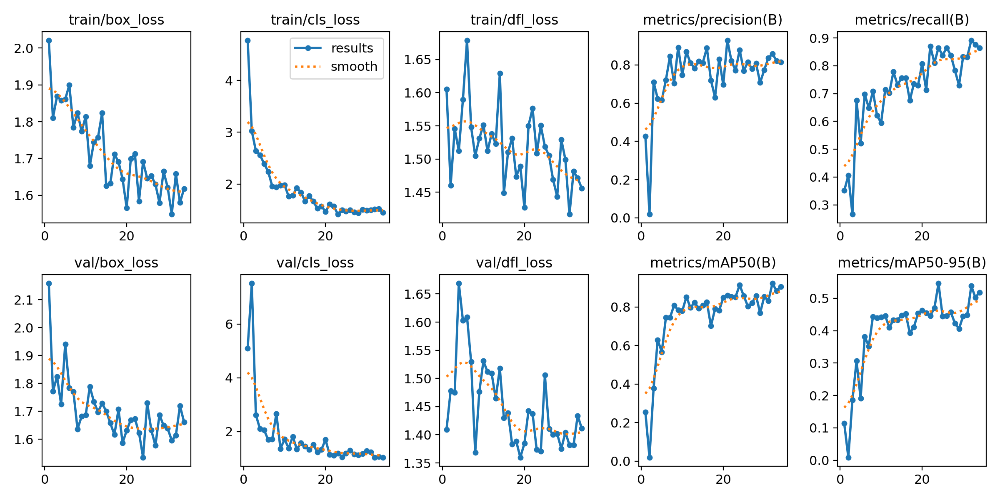

In [15]:
from IPython.display import Image

Image('dropcap-runs/dropcap-yolov8n/results.png')


image 1/1 /content/dropcap_300/test/images/4419e418fb3dfbb8d2cbea13e2877140_jpg.rf.ce820c61518cb2718d737e76abc67658.jpg: 640x640 1 dropcap, 15.9ms
Speed: 2.6ms preprocess, 15.9ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


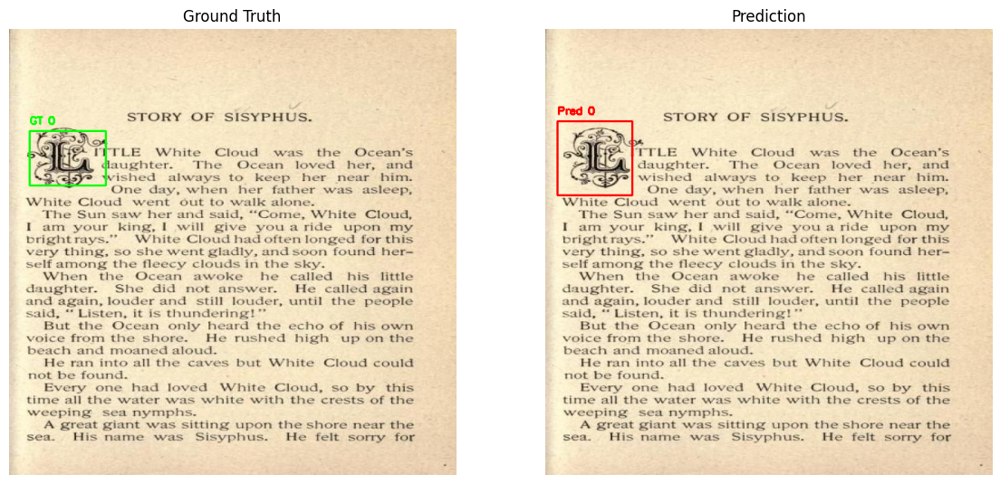

In [19]:
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import os

model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')

def load_labels(label_path):
    """Load YOLO labels from txt file."""
    boxes = []
    with open(label_path, 'r') as f:
        for line in f.readlines():
            cls, x_c, y_c, w, h = map(float, line.strip().split())
            boxes.append((int(cls), x_c, y_c, w, h))
    return boxes

def draw_boxes(image, boxes, color=(0,255,0), label_prefix='GT'):

    h, w = image.shape[:2]
    for (cls, x_c, y_c, bw, bh) in boxes:
        # Convert normalized coordinates to pixels
        x1 = int((x_c - bw/2) * w)
        y1 = int((y_c - bh/2) * h)
        x2 = int((x_c + bw/2) * w)
        y2 = int((y_c + bh/2) * h)
        cv2.rectangle(image, (x1,y1), (x2,y2), color, 2)
        cv2.putText(image, f"{label_prefix} {cls}", (x1, y1-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return image


img_path = '/content/dropcap_300/test/images/4419e418fb3dfbb8d2cbea13e2877140_jpg.rf.ce820c61518cb2718d737e76abc67658.jpg'
label_path = '/content/dropcap_300/test/labels/4419e418fb3dfbb8d2cbea13e2877140_jpg.rf.ce820c61518cb2718d737e76abc67658.txt'

img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

#ground truth
gt_boxes = load_labels(label_path)
img_gt = img.copy()
img_gt = draw_boxes(img_gt, gt_boxes, color=(0,255,0), label_prefix='GT')


results = model(img_path)
pred_boxes = []
for box in results[0].boxes.data.tolist():
    # box format: [x1, y1, x2, y2, score, class]
    x1, y1, x2, y2, conf, cls = box
    w = x2 - x1
    h = y2 - y1
    x_c = (x1 + x2)/2
    y_c = (y1 + y2)/2
    img_w, img_h = img.shape[1], img.shape[0]
    pred_boxes.append((
        int(cls),
        x_c/img_w,
        y_c/img_h,
        w/img_w,
        h/img_h
    ))


img_pred = img.copy()
img_pred = draw_boxes(img_pred, pred_boxes, color=(255,0,0), label_prefix='Pred')

# Plot GT and Predicted
plt.figure(figsize=(14,7))
plt.subplot(1,2,1)
plt.title('Ground Truth')
plt.imshow(img_gt)
plt.axis('off')

plt.subplot(1,2,2)
plt.title('Prediction')
plt.imshow(img_pred)
plt.axis('off')

plt.show()


In [20]:
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Load trained model
model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')

def load_labels(label_path):
    """Load YOLO-format labels from txt file."""
    boxes = []
    with open(label_path, 'r') as f:
        for line in f.readlines():
            cls, x_c, y_c, w, h = map(float, line.strip().split())
            boxes.append((int(cls), x_c, y_c, w, h))
    return boxes

def draw_boxes(image, boxes, color=(0,255,0), label_prefix='GT'):
    """Draw bounding boxes on an image."""
    h, w = image.shape[:2]
    for (cls, x_c, y_c, bw, bh) in boxes:
        x1 = int((x_c - bw/2) * w)
        y1 = int((y_c - bh/2) * h)
        x2 = int((x_c + bw/2) * w)
        y2 = int((y_c + bh/2) * h)
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(image, f"{label_prefix} {cls}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return image

def visualize_gt_and_prediction(image_path, label_path):
    """Visualize ground truth and YOLOv8 predictions side-by-side."""
    # Load image
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Draw Ground Truth
    gt_boxes = load_labels(label_path)
    img_gt = draw_boxes(img.copy(), gt_boxes, color=(0, 255, 0), label_prefix='GT')

    # Run prediction
    results = model(image_path)
    pred_boxes = []
    img_h, img_w = img.shape[:2]

    for box in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = box
        w = x2 - x1
        h = y2 - y1
        x_c = (x1 + x2) / 2
        y_c = (y1 + y2) / 2
        pred_boxes.append((
            int(cls),
            x_c / img_w,
            y_c / img_h,
            w / img_w,
            h / img_h
        ))

    # Draw Prediction
    img_pred = draw_boxes(img.copy(), pred_boxes, color=(255, 0, 0), label_prefix='Pred')

    # Plot
    plt.figure(figsize=(14, 7))
    plt.subplot(1, 2, 1)
    plt.title('Ground Truth')
    plt.imshow(img_gt)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Prediction')
    plt.imshow(img_pred)
    plt.axis('off')

    plt.tight_layout()
    plt.show()



image 1/1 /content/dropcap_300/test/images/d436924174b3c87954b3b4af146a4073_jpg.rf.033f2c58f19d8f6ed2f1fea3ebc2e615.jpg: 640x640 3 dropcaps, 19.2ms
Speed: 2.4ms preprocess, 19.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


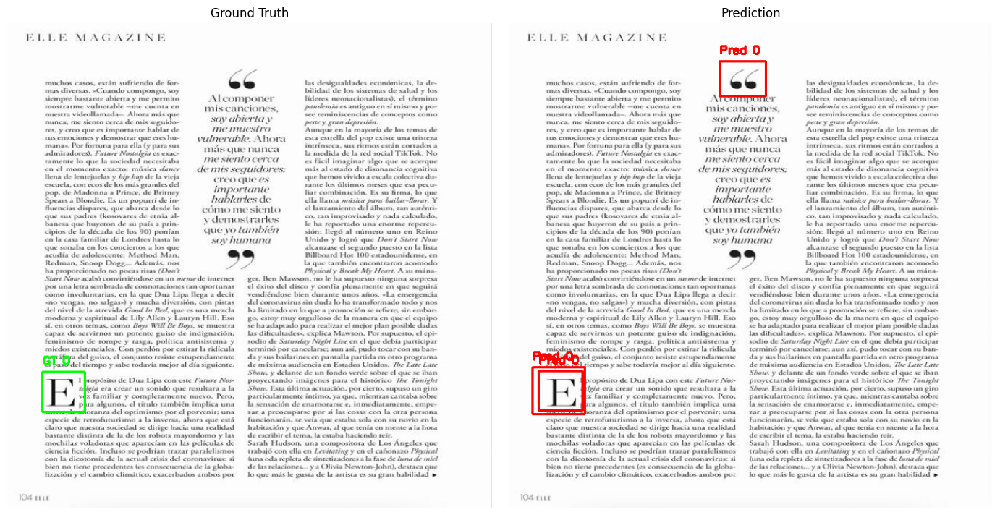

In [21]:
visualize_gt_and_prediction(
    '/content/dropcap_300/test/images/d436924174b3c87954b3b4af146a4073_jpg.rf.033f2c58f19d8f6ed2f1fea3ebc2e615.jpg',
    '/content/dropcap_300/test/labels/d436924174b3c87954b3b4af146a4073_jpg.rf.033f2c58f19d8f6ed2f1fea3ebc2e615.txt'
)



image 1/1 /content/dropcap_300/test/images/7b336db90e4241e823d21aae86cfc206_jpg.rf.92de4c7fcbce4749260253b4d744cd04.jpg: 640x640 1 dropcap, 16.1ms
Speed: 2.4ms preprocess, 16.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


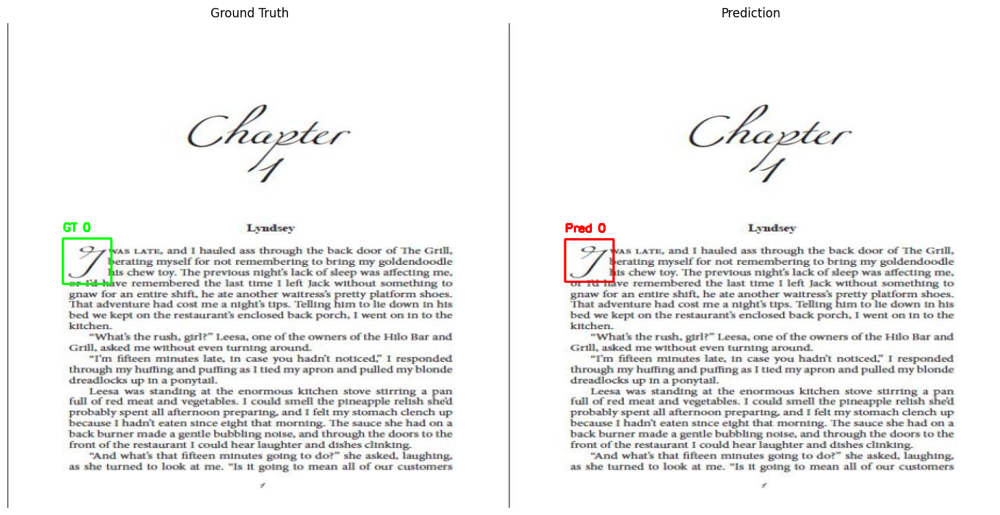

In [22]:
visualize_gt_and_prediction(
    '/content/dropcap_300/test/images/7b336db90e4241e823d21aae86cfc206_jpg.rf.92de4c7fcbce4749260253b4d744cd04.jpg',
    '/content/dropcap_300/test/labels/7b336db90e4241e823d21aae86cfc206_jpg.rf.92de4c7fcbce4749260253b4d744cd04.txt'
)



image 1/1 /content/1644721472440-2.jpeg: 544x640 2 dropcaps, 77.1ms
Speed: 3.9ms preprocess, 77.1ms inference, 2.4ms postprocess per image at shape (1, 3, 544, 640)


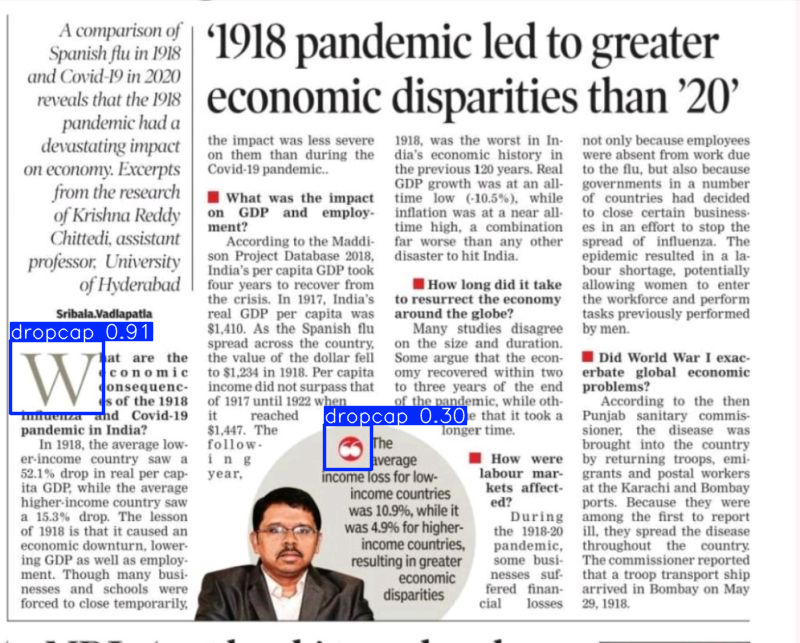

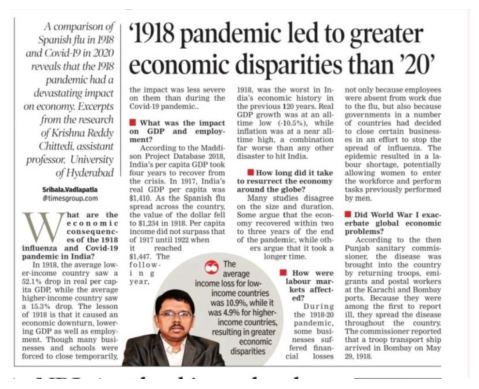

In [23]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')

path = '/content/1644721472440-2.jpeg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/decorative-lettering-step5_900x506-2.jpg: 512x896 2 dropcaps, 104.1ms
Speed: 7.1ms preprocess, 104.1ms inference, 2.3ms postprocess per image at shape (1, 3, 512, 896)


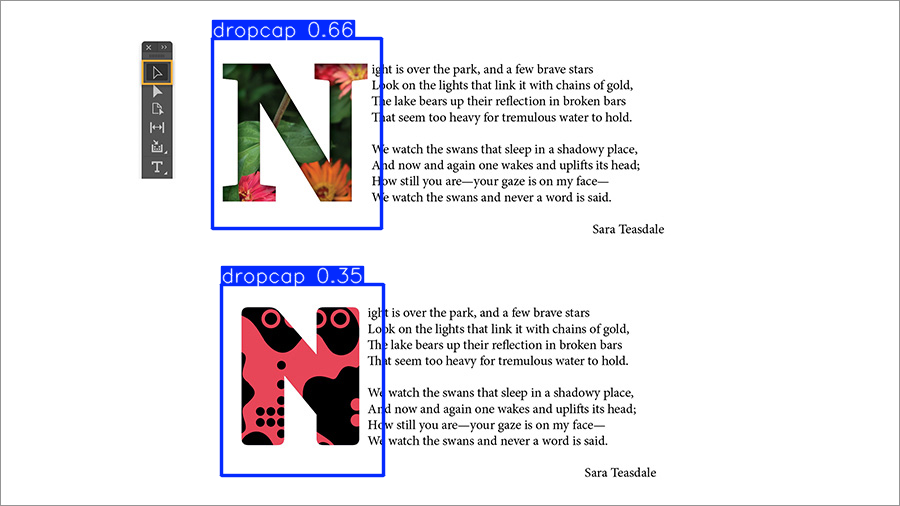

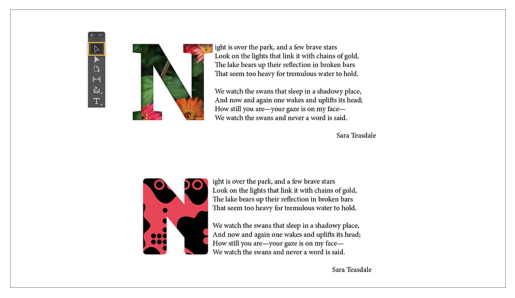

In [53]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/decorative-lettering-step5_900x506-2.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/6f1339bd2c923bf6dba1fffb93495a04_jpg.rf.2cd6c5fa0b7876b4fea200ebfdb5e405.jpg: 640x640 1 dropcap, 15.9ms
Speed: 2.4ms preprocess, 15.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


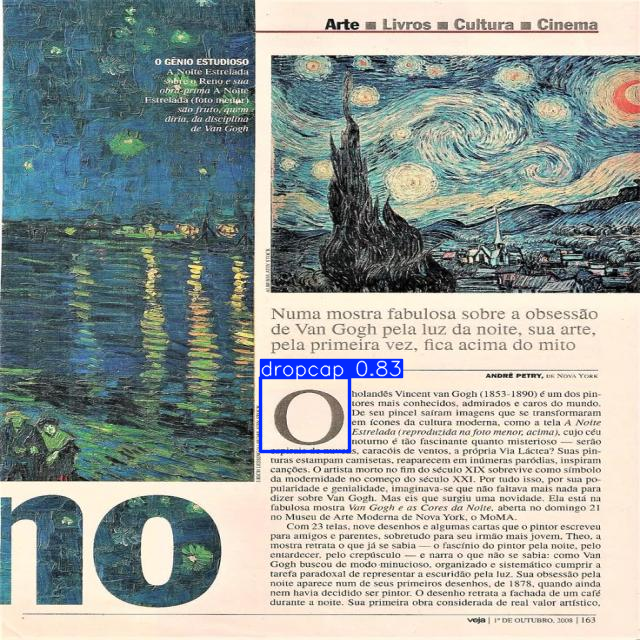

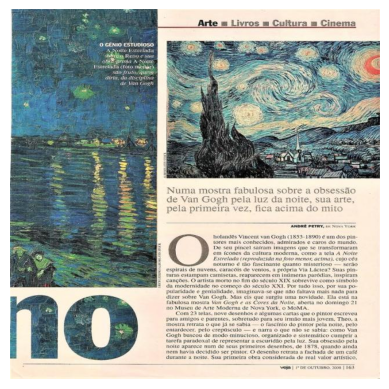

In [28]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('/content/dropcap-runs/dropcap-yolov8n/weights/best.pt')

path = '/content/6f1339bd2c923bf6dba1fffb93495a04_jpg.rf.2cd6c5fa0b7876b4fea200ebfdb5e405.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
model.val(data='/content/dropcap_yolov8/data.yaml', device=0)

Ultralytics 8.3.153 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2002.5±536.5 MB/s, size: 122.5 KB)


val: Scanning /content/dropcap_yolov8/valid/labels.cache... 9 images, 1 backgrounds, 0 corrupt: 100%|██████████| 9/9 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]


                   all          9         10      0.898        0.9      0.937      0.678
Speed: 0.3ms preprocess, 15.1ms inference, 0.0ms loss, 6.7ms postprocess per image
Results saved to runs/detect/val2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c9bdf588290>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

| Metric                 | Value                | Meaning                                                      |
| ---------------------- | -------------------- | ------------------------------------------------------------ |
| `metrics/precision(B)` | **0.888**            | Of all predicted drop caps, \~88.8% were correct. Very good. |
| `metrics/recall(B)`    | **0.9**              | The model found 90% of actual drop caps. Excellent recall.   |
| `metrics/mAP50(B)`     | **0.925**            | Mean Average Precision at IoU=0.5. Strong performance.       |
| `metrics/mAP50-95(B)`  | **0.669**            | mAP at IoU from 0.5 to 0.95. More strict, still solid.       |



image 1/1 /content/dropcap_300/test/images/2769f101843bbb1b88513bbac60d4f67_jpg.rf.7b2d581b1af6156b52ee886b236b1710.jpg: 640x640 1 dropcap, 15.9ms
Speed: 2.3ms preprocess, 15.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


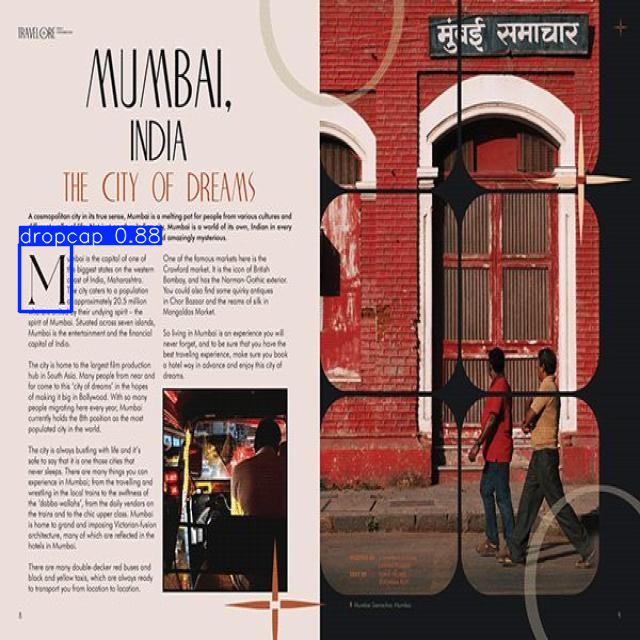

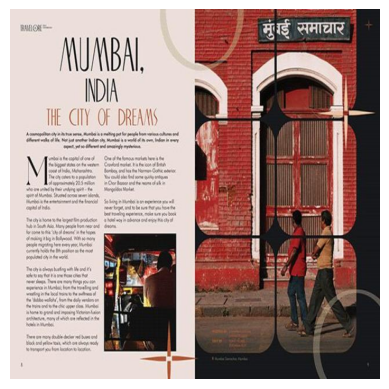

In [29]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('/content/dropcap-runs/dropcap-yolov8n/weights/best.pt')

path = '/content/dropcap_300/test/images/2769f101843bbb1b88513bbac60d4f67_jpg.rf.7b2d581b1af6156b52ee886b236b1710.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()

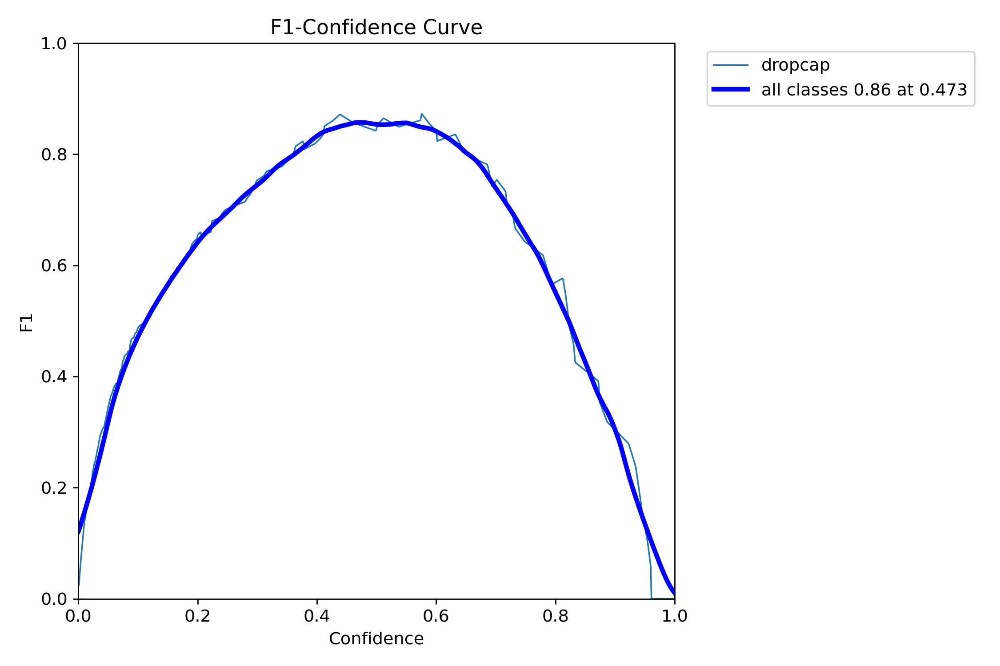

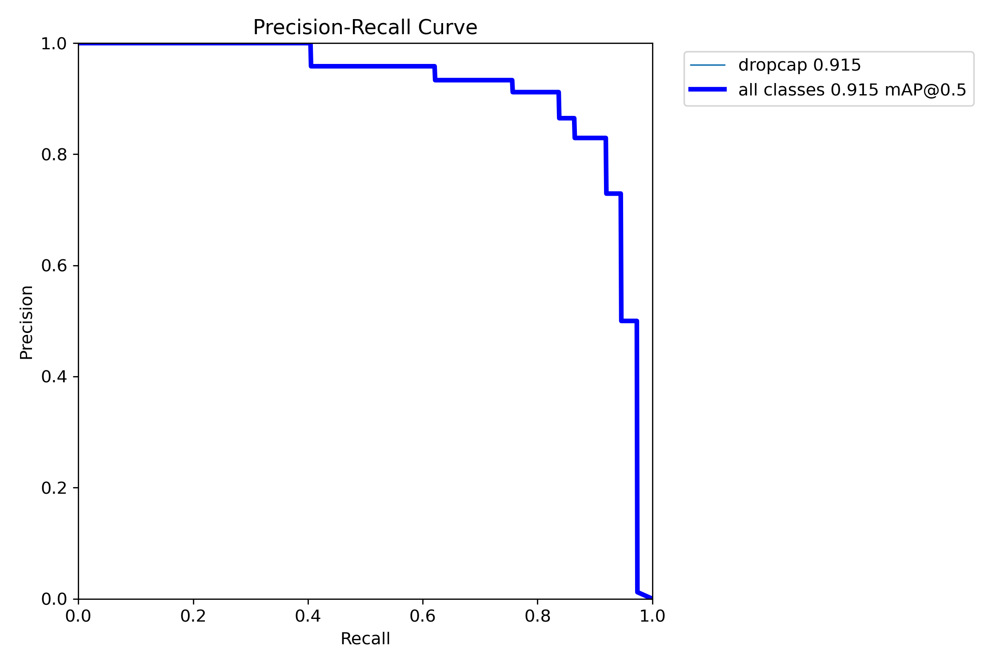

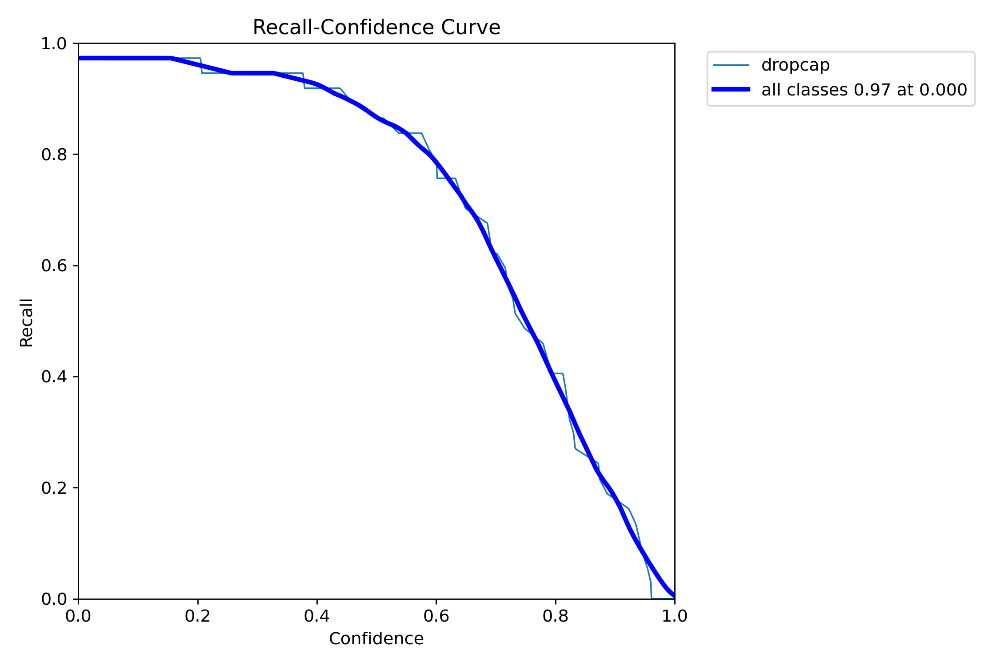

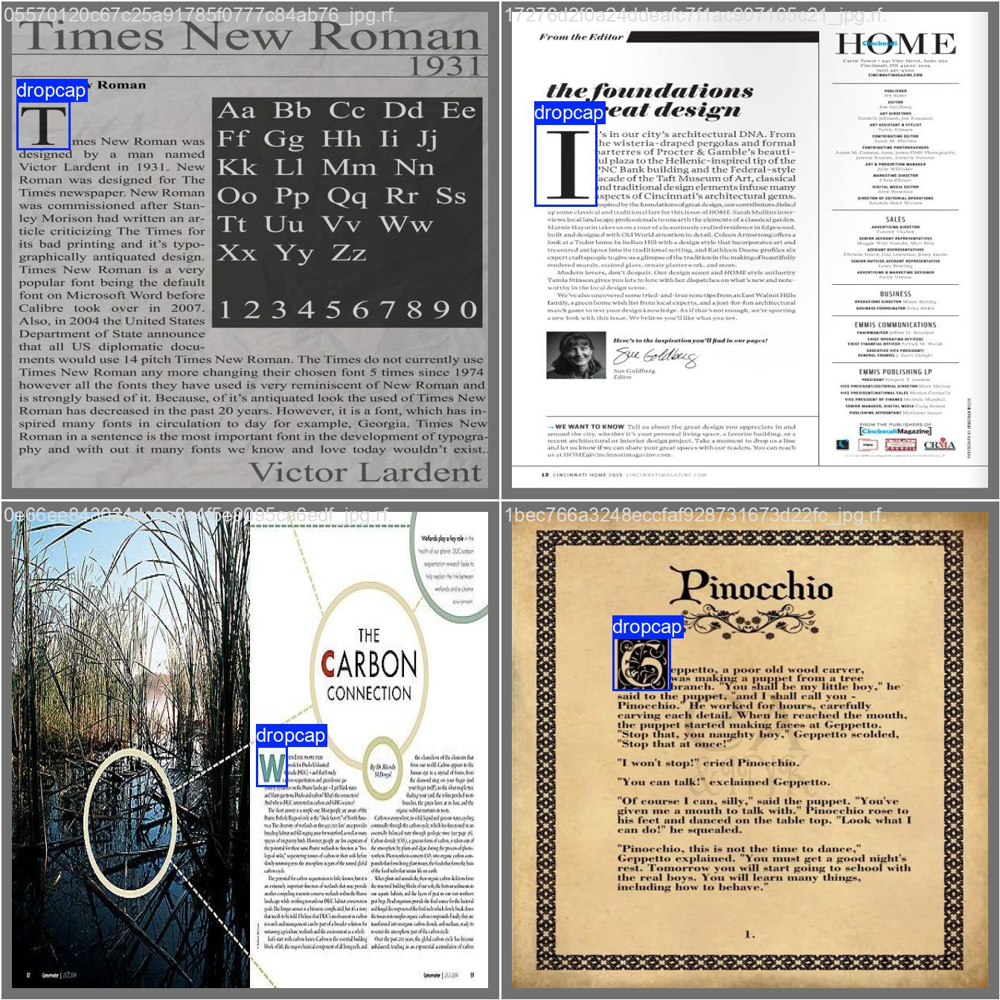

In [30]:
from IPython.display import Image, display

display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/F1_curve.png'))
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/PR_curve.png'))
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/R_curve.png'))
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch0_labels.jpg'))

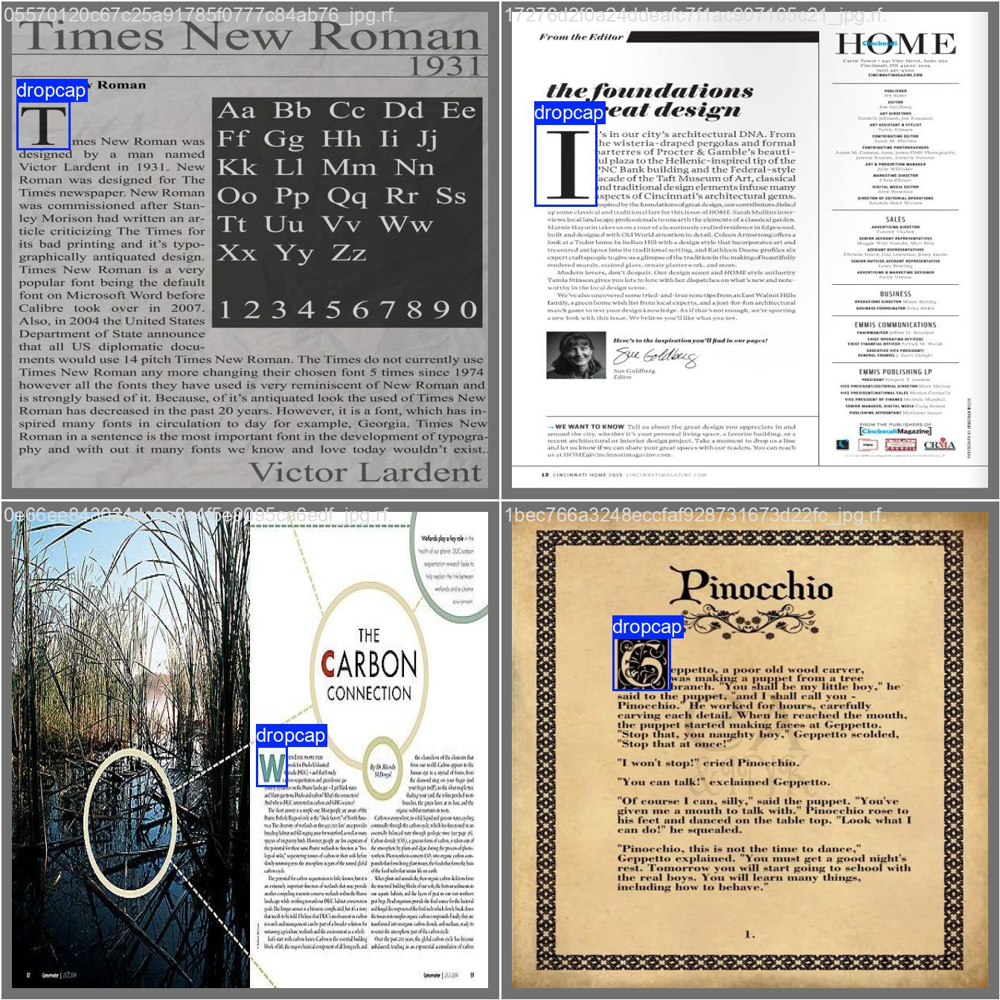

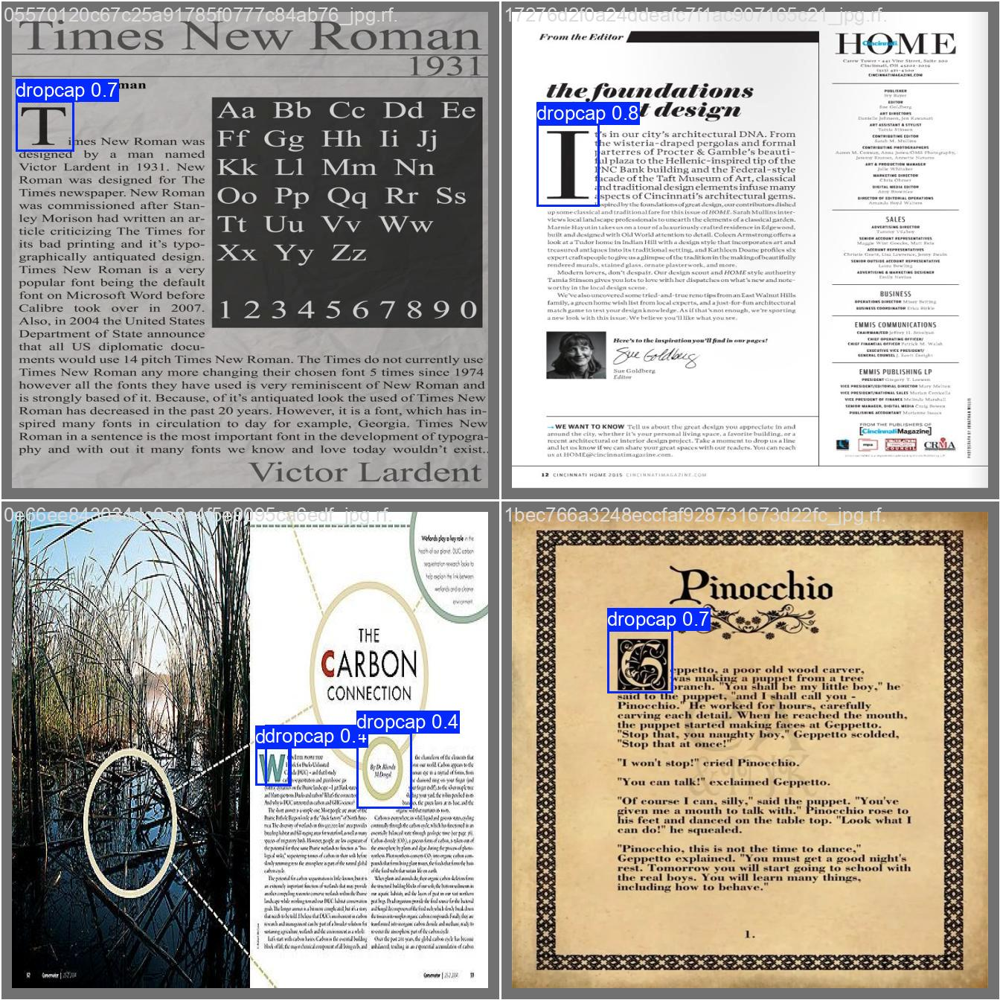

In [31]:
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch0_labels.jpg'))
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch0_pred.jpg'))

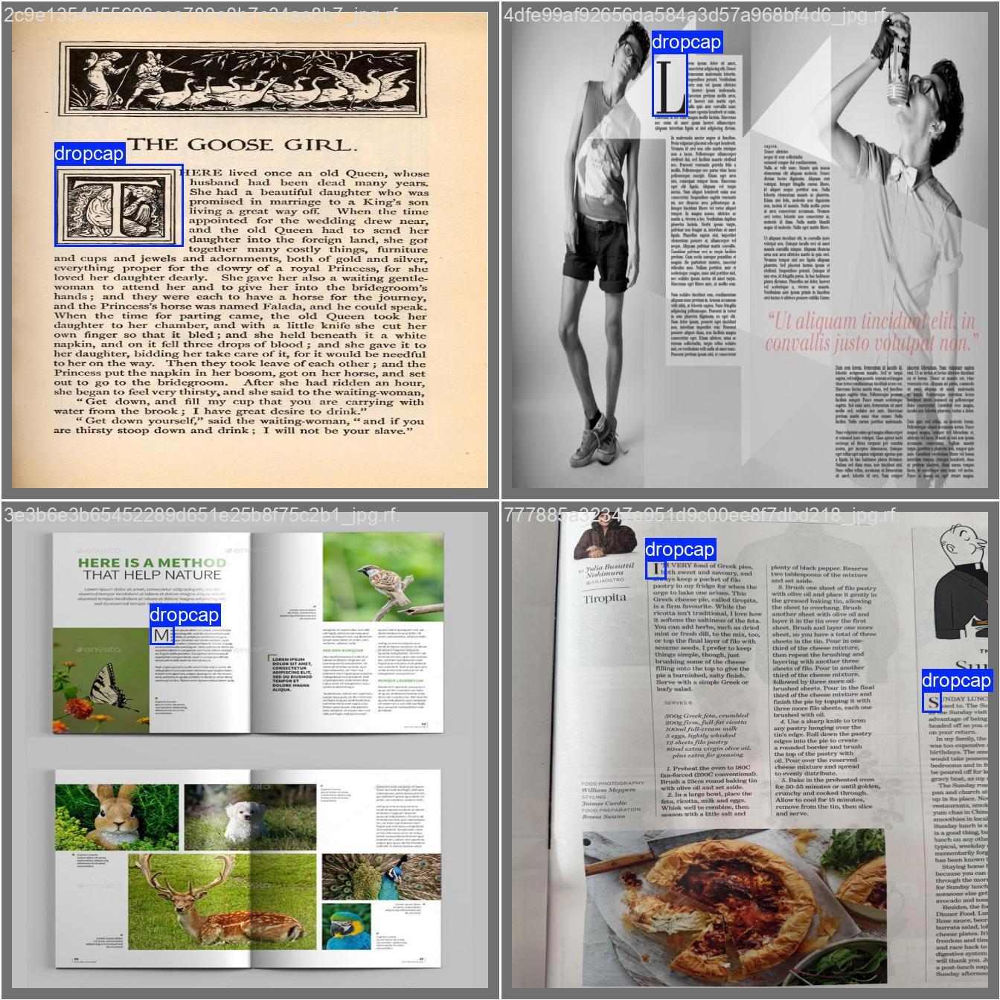

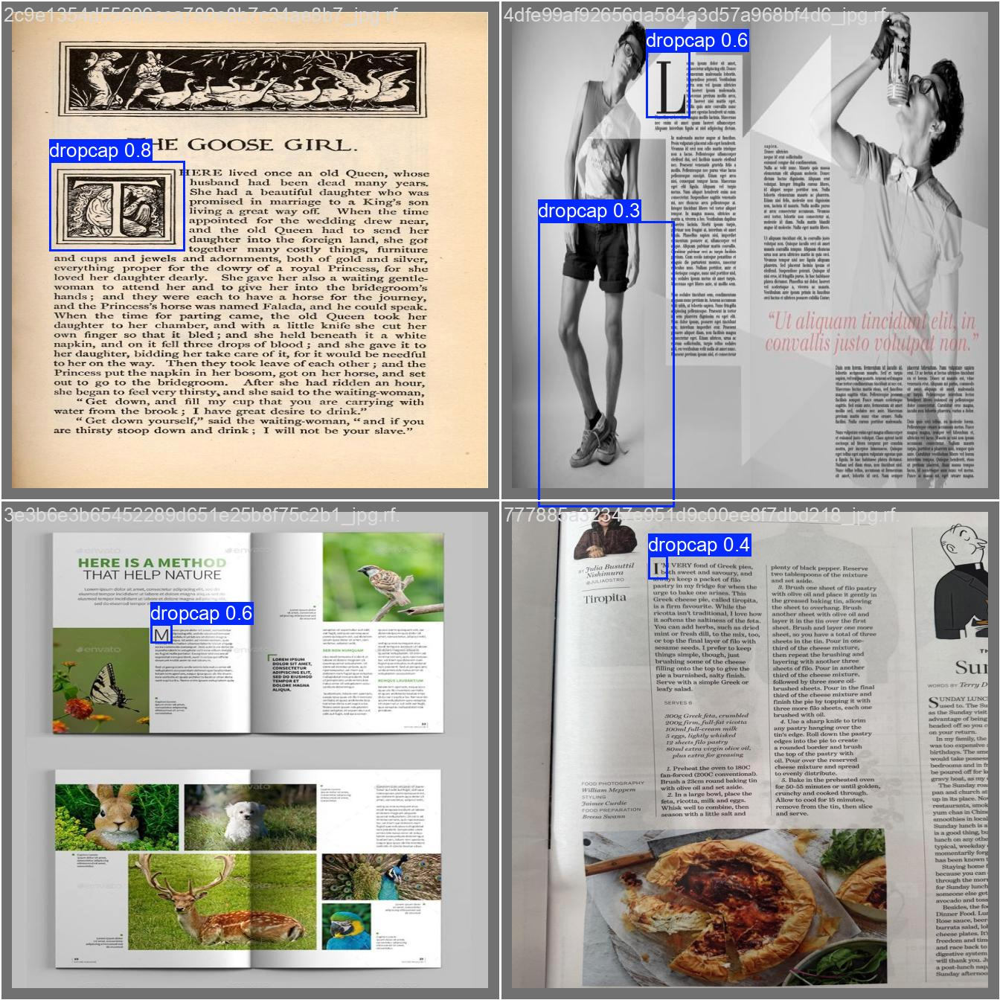

In [32]:
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch1_labels.jpg'))
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch1_pred.jpg'))

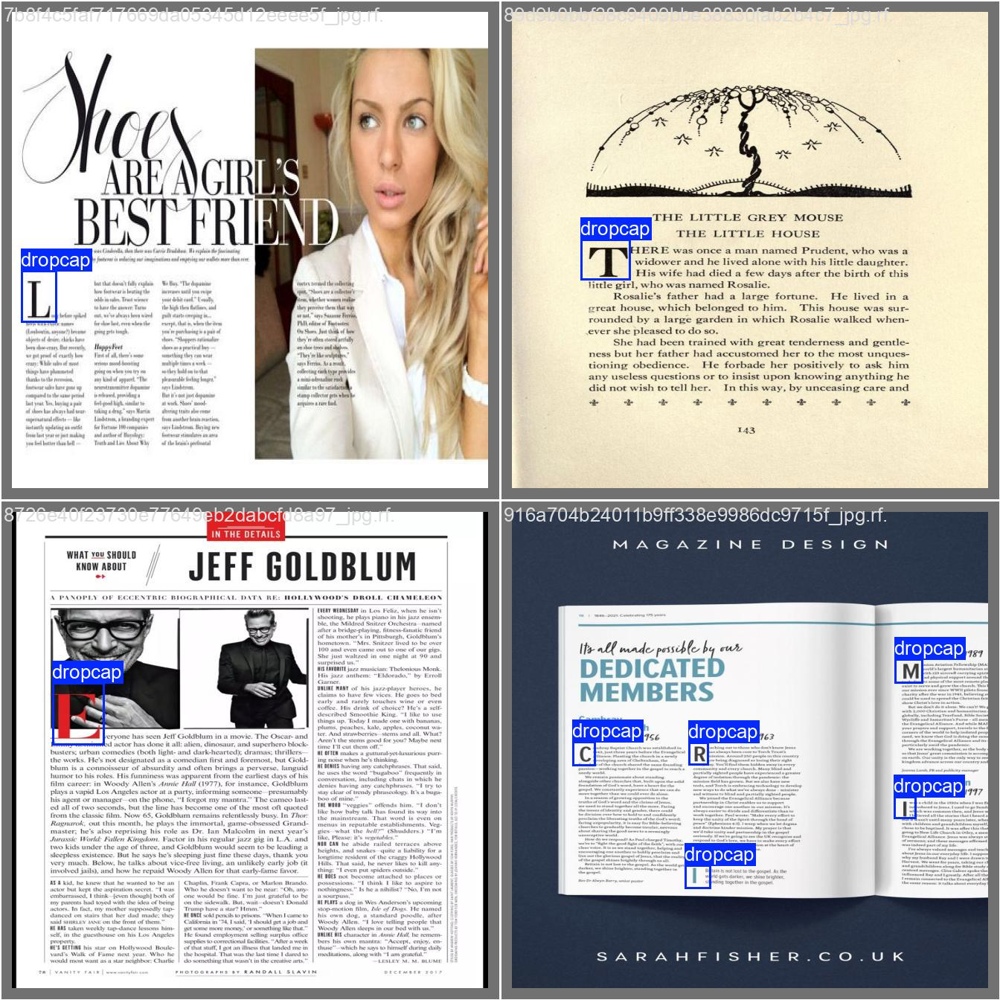

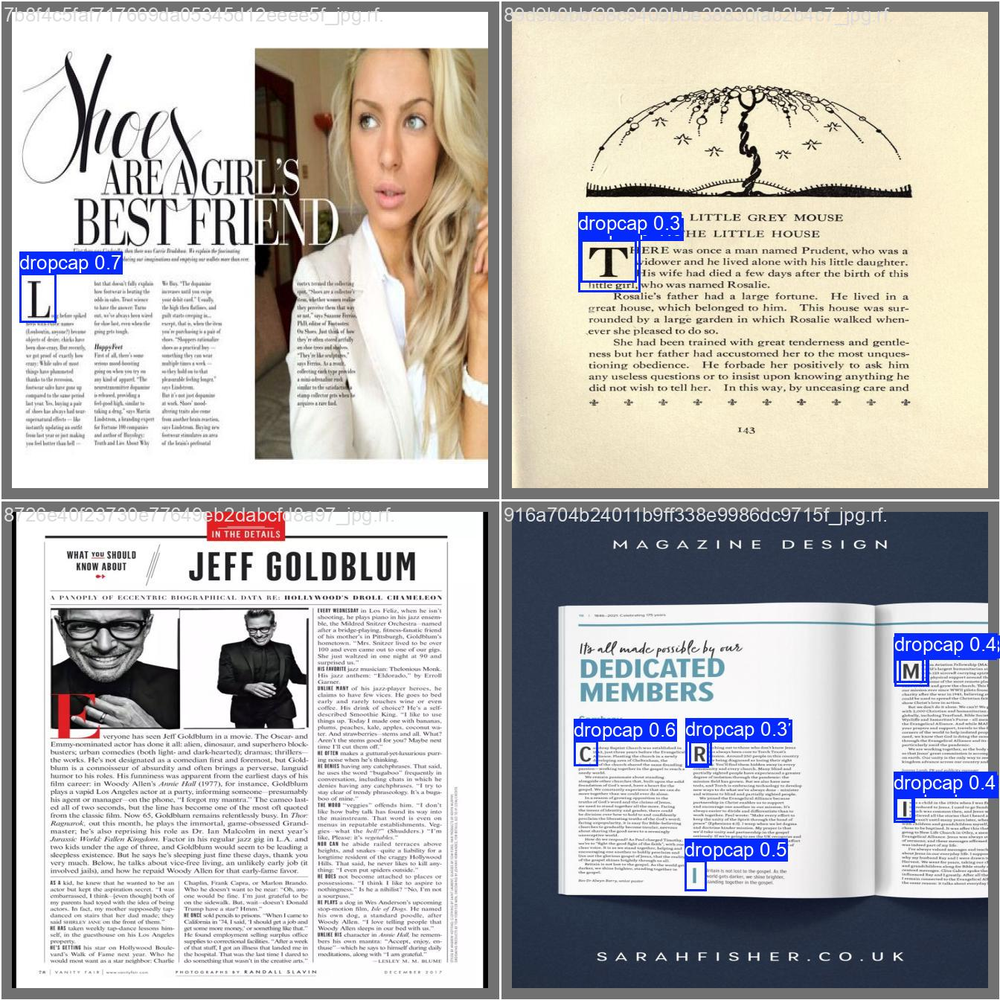

In [33]:
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch2_labels.jpg'))
display(Image(filename='/content/dropcap-runs/dropcap-yolov8n/val_batch2_pred.jpg'))

In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('/content/dropcap-runs/dropcap-yolov8n/weights/best.pt')

path = '/content/dropcap_yolov8/test/images/d7ec5ae22a51496397c618ef3bea7834_jpg.rf.536c153fa63722950baf45b88fa2ae38.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()

In [34]:
model.train(
    data='/content/dropcap_300/data.yaml',
    epochs=150,
    imgsz=896,
    batch=4,
    name='dropcap-v2',
    project='dropcap-runs',
    degrees=10,
    scale=0.2,
    translate=0.1,
    shear=2.0,
    perspective=0.0005
)


Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dropcap_300/data.yaml, degrees=10, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=896, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/dropcap-runs/dropcap-yolov8n/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=dropcap-v2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, p

train: Scanning /content/dropcap_300/train/labels.cache... 202 images, 0 backgrounds, 0 corrupt: 100%|██████████| 202/202 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 292.3±162.8 MB/s, size: 75.1 KB)


val: Scanning /content/dropcap_300/valid/labels.cache... 29 images, 0 backgrounds, 0 corrupt: 100%|██████████| 29/29 [00:00<?, ?it/s]


Plotting labels to dropcap-runs/dropcap-v2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 896 train, 896 val
Using 2 dataloader workers
Logging results to dropcap-runs/dropcap-v2
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      2.21G      1.941      3.478      1.991          8        896: 100%|██████████| 51/51 [00:10<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all         29         37      0.924      0.676      0.796      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      2.21G      1.899      2.992      1.845          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.29it/s]

                   all         29         37      0.946      0.703      0.884      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      2.21G      1.811      2.542      1.741          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all         29         37       0.91      0.838      0.913      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      2.21G      1.689      2.219      1.607          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.28it/s]

                   all         29         37      0.968      0.892       0.93      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      2.21G      1.676      2.248      1.646          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.58it/s]

                   all         29         37      0.876      0.838      0.906      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      2.36G      1.727      1.968      1.716          5        896: 100%|██████████| 51/51 [00:08<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]

                   all         29         37      0.911      0.865      0.924      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      2.36G      1.604      1.753      1.568          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.01it/s]

                   all         29         37      0.792      0.892      0.877      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      2.36G      1.759      1.754      1.672          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.32it/s]

                   all         29         37          1      0.782      0.888      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      2.36G      1.617      1.563      1.596          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.42it/s]

                   all         29         37      0.887      0.946      0.961       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      2.36G      1.663      1.656       1.69          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.12it/s]

                   all         29         37      0.915      0.878      0.939      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      2.52G      1.558      1.466      1.567          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.37it/s]

                   all         29         37      0.969      0.838      0.952      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      2.52G      1.721      1.657      1.654          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]

                   all         29         37       0.92      0.934      0.947      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      2.52G      1.529      1.453      1.544          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.55it/s]

                   all         29         37      0.904      0.892      0.936      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      2.52G      1.616      1.424      1.572          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.02it/s]

                   all         29         37       0.86      0.757      0.887      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      2.52G      1.519      1.436      1.536          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.05it/s]

                   all         29         37      0.891      0.784      0.898       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      2.54G      1.562      1.317      1.548          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.34it/s]

                   all         29         37      0.928      0.919       0.96      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      2.55G      1.567      1.347      1.562          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.19it/s]

                   all         29         37      0.927      0.919      0.951      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      2.55G      1.498      1.237      1.512          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.22it/s]

                   all         29         37      0.929      0.865      0.921      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      2.55G      1.525      1.311      1.581          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.06it/s]

                   all         29         37      0.869      0.895      0.928      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      2.55G      1.558      1.217      1.551          4        896: 100%|██████████| 51/51 [00:10<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.82it/s]

                   all         29         37      0.913      0.865      0.939      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      2.55G      1.571      1.265      1.547          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.44it/s]

                   all         29         37      0.942      0.883      0.971      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      2.55G       1.54      1.294      1.558          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         29         37      0.967      0.919      0.963      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      2.55G      1.552      1.154      1.528          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.12it/s]

                   all         29         37      0.802      0.946      0.901      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      2.55G      1.538      1.259      1.599          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.29it/s]

                   all         29         37      0.872      0.865      0.902      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      2.55G      1.444      1.096      1.435          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.26it/s]

                   all         29         37      0.889      0.784      0.899      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      2.55G      1.545      1.268       1.56          8        896: 100%|██████████| 51/51 [00:08<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.63it/s]

                   all         29         37      0.884      0.838      0.941      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      2.55G      1.522      1.231      1.581          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.89it/s]

                   all         29         37      0.994      0.811      0.954       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      2.55G      1.442      1.167      1.483          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.43it/s]

                   all         29         37      0.945      0.927      0.978      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      2.55G      1.466      1.145      1.514          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.20it/s]

                   all         29         37      0.916      0.892      0.952      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      2.55G      1.513      1.168      1.585          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.33it/s]

                   all         29         37      0.939      0.828       0.89      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      2.55G      1.498      1.196      1.564          7        896: 100%|██████████| 51/51 [00:08<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.21it/s]

                   all         29         37      0.944      0.915      0.943      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      2.55G      1.495      1.137      1.531          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.38it/s]

                   all         29         37      0.918      0.912      0.957      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      2.55G      1.461      1.091      1.491          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.32it/s]

                   all         29         37       0.92      0.932      0.962      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      2.55G      1.519      1.139      1.513          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.30it/s]

                   all         29         37      0.972      0.943      0.953      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      2.55G      1.462      1.047      1.466          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.75it/s]

                   all         29         37      0.833      0.941      0.926      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      2.55G      1.509      1.165      1.506          1        896: 100%|██████████| 51/51 [00:09<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.92it/s]

                   all         29         37      0.971      0.912      0.941      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      2.55G      1.375      1.063      1.472          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.25it/s]

                   all         29         37      0.871      0.946      0.925       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      2.55G      1.432      1.103      1.515          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.41it/s]

                   all         29         37      0.941      0.946      0.926      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      2.55G      1.383      1.058      1.519          1        896: 100%|██████████| 51/51 [00:09<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.25it/s]

                   all         29         37      0.941      0.919      0.939      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      2.55G      1.434      1.095       1.47          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.71it/s]

                   all         29         37      0.897      0.944      0.935      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      2.55G      1.445      1.043      1.513          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.04it/s]

                   all         29         37      0.944      0.917      0.938      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      2.55G      1.424       1.03      1.459          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.11it/s]

                   all         29         37      0.988      0.838      0.915      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      2.55G      1.402     0.9632      1.466          6        896: 100%|██████████| 51/51 [00:09<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.85it/s]

                   all         29         37       0.93      0.892      0.967      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      2.55G      1.489      1.082      1.522          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.16it/s]

                   all         29         37      0.887      0.946      0.948      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      2.55G      1.434          1      1.453          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.19it/s]

                   all         29         37      0.795      0.973      0.908      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      2.55G      1.409       0.97      1.448          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.42it/s]

                   all         29         37      0.919      0.919      0.966      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      2.55G      1.457      1.008      1.512          2        896: 100%|██████████| 51/51 [00:10<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         29         37      0.919      0.946      0.957      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      2.55G       1.44      1.006      1.458          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.67it/s]

                   all         29         37      0.916      0.884      0.943      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      2.55G      1.424      1.004       1.45          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.35it/s]

                   all         29         37      0.939      0.865       0.96      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      2.55G      1.367     0.9571      1.432          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.11it/s]

                   all         29         37      0.943      0.892      0.957      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      2.55G      1.379     0.9959      1.439          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.66it/s]

                   all         29         37      0.871      0.946      0.948      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      2.55G       1.39      1.053      1.447          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.76it/s]

                   all         29         37      0.938      0.946      0.956      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      2.55G      1.303     0.9098      1.406          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.53it/s]

                   all         29         37      0.951      0.865      0.942      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      2.55G      1.365      1.064      1.412          2        896: 100%|██████████| 51/51 [00:10<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.70it/s]

                   all         29         37      0.934      0.946      0.959      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      2.55G      1.411     0.9529       1.44          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.66it/s]

                   all         29         37      0.899      0.965      0.969      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      2.55G      1.311     0.8969      1.391          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         29         37       0.94      0.892      0.958      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      2.55G      1.374     0.9416      1.439          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.15it/s]

                   all         29         37      0.918      0.919      0.955      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      2.55G      1.351     0.9328      1.398          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.36it/s]

                   all         29         37      0.946      0.942      0.952      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      2.55G      1.394     0.9653      1.427          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.00it/s]

                   all         29         37          1      0.878      0.921      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      2.55G      1.358     0.9351      1.435          4        896: 100%|██████████| 51/51 [00:08<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.37it/s]

                   all         29         37      0.928      0.892      0.915       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      2.55G      1.344     0.9122      1.398          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.93it/s]

                   all         29         37       0.94      0.865       0.93      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      2.55G      1.307     0.8763      1.403          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.12it/s]

                   all         29         37      0.989      0.838      0.926      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      2.55G      1.428      1.025      1.469          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.13it/s]

                   all         29         37      0.992      0.865      0.921      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      2.55G      1.402     0.9153      1.409          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.36it/s]

                   all         29         37      0.914      0.865      0.944       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      2.55G      1.339     0.9445      1.437          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.00it/s]

                   all         29         37      0.918      0.919      0.936      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      2.55G      1.315      0.935      1.388          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.99it/s]

                   all         29         37       0.94      0.919      0.973      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      2.55G      1.369     0.8798      1.413          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.41it/s]

                   all         29         37       0.96      0.892      0.954      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      2.55G       1.28     0.8904       1.37          3        896: 100%|██████████| 51/51 [00:10<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.95it/s]

                   all         29         37      0.944      0.913      0.935      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      2.55G      1.354     0.8842      1.405          1        896: 100%|██████████| 51/51 [00:10<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.38it/s]

                   all         29         37      0.923      0.892      0.951      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      2.55G      1.246      0.854      1.348          5        896: 100%|██████████| 51/51 [00:08<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.99it/s]

                   all         29         37      0.967      0.892      0.935       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      2.55G      1.284     0.8107      1.329          6        896: 100%|██████████| 51/51 [00:09<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.66it/s]

                   all         29         37      0.968      0.892      0.946      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      2.55G      1.318     0.8383      1.381          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.97it/s]

                   all         29         37      0.928      0.892      0.955      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      2.55G      1.268     0.8941      1.372          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.23it/s]

                   all         29         37      0.959      0.919      0.962      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      2.55G      1.321     0.8692      1.399          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.40it/s]

                   all         29         37      0.947      0.966      0.975       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      2.55G       1.33     0.9088       1.38          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.43it/s]

                   all         29         37      0.962      0.892      0.954      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      2.55G      1.358     0.9162      1.412          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.21it/s]

                   all         29         37      0.963      0.892      0.947      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      2.55G      1.296     0.9105       1.37          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.24it/s]

                   all         29         37      0.944      0.915       0.95      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      2.55G      1.288     0.8328       1.37          5        896: 100%|██████████| 51/51 [00:10<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.79it/s]

                   all         29         37       0.97      0.946      0.963      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      2.55G      1.232     0.7943      1.349          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.68it/s]

                   all         29         37      0.967      0.919      0.961      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      2.55G      1.246     0.8606      1.356          2        896: 100%|██████████| 51/51 [00:11<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.23it/s]

                   all         29         37      0.972      0.944      0.954       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      2.55G      1.248     0.8613      1.336          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.15it/s]

                   all         29         37      0.942      0.919       0.96       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      2.55G       1.29     0.8539      1.373          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.68it/s]

                   all         29         37      0.939      0.892      0.964      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      2.55G       1.23     0.8444      1.344          5        896: 100%|██████████| 51/51 [00:10<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.11it/s]

                   all         29         37      0.945      0.892      0.966      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      2.55G      1.204      0.781      1.351          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.58it/s]

                   all         29         37      0.937      0.892      0.951      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      2.55G      1.245     0.8272      1.304          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.74it/s]

                   all         29         37      0.956      0.892      0.948      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      2.55G       1.22     0.8174      1.308          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.33it/s]

                   all         29         37       0.97      0.864      0.936      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      2.55G      1.243     0.8306      1.344          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.83it/s]

                   all         29         37       0.97      0.861      0.938      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      2.55G      1.194      0.774      1.267          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all         29         37      0.943      0.888      0.949      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      2.55G       1.22     0.7401      1.301          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.75it/s]

                   all         29         37      0.939      0.919      0.957      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      2.55G      1.206     0.7868      1.306          3        896: 100%|██████████| 51/51 [00:10<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.47it/s]

                   all         29         37      0.972      0.942      0.971      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      2.55G      1.249     0.8631      1.363          4        896: 100%|██████████| 51/51 [00:08<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.61it/s]

                   all         29         37      0.972      0.943      0.983      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      2.55G      1.153     0.7478      1.263          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.60it/s]

                   all         29         37      0.939      0.946      0.983      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      2.55G      1.198     0.8155      1.305          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.34it/s]

                   all         29         37      0.945      0.946      0.986      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      2.55G      1.186     0.8046      1.322          1        896: 100%|██████████| 51/51 [00:09<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.01it/s]

                   all         29         37      0.947      0.969      0.989      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      2.55G      1.183     0.7743      1.311          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.48it/s]

                   all         29         37      0.988      0.919       0.99      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      2.55G      1.204     0.7666       1.34          1        896: 100%|██████████| 51/51 [00:08<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.18it/s]

                   all         29         37      0.967      0.919      0.976      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      2.58G      1.207     0.7498      1.299          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.62it/s]

                   all         29         37       0.97      0.919      0.971      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      2.58G      1.241     0.7789      1.334          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.66it/s]

                   all         29         37      0.978      0.919      0.963      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      2.58G      1.204     0.8217      1.335          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.30it/s]

                   all         29         37      0.966      0.919      0.979        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      2.58G      1.164     0.7374        1.3          5        896: 100%|██████████| 51/51 [00:10<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.89it/s]

                   all         29         37      0.943      0.946      0.977      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      2.58G      1.186     0.7882      1.294          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.54it/s]

                   all         29         37      0.964      0.946      0.978      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      2.58G      1.154      0.709      1.274          6        896: 100%|██████████| 51/51 [00:11<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.00it/s]

                   all         29         37      0.937      0.946      0.978      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      2.58G       1.15     0.7267      1.281          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.11it/s]

                   all         29         37      0.966      0.919      0.983       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      2.58G      1.199     0.8069      1.323          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.78it/s]

                   all         29         37      0.969      0.919      0.964      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      2.58G      1.157     0.7664      1.295          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.51it/s]

                   all         29         37      0.969      0.919      0.954      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      2.58G      1.154     0.7267        1.3          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.20it/s]

                   all         29         37      0.971      0.914      0.942      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      2.58G      1.171      0.717      1.296          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.24it/s]

                   all         29         37      0.972       0.94      0.951      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      2.58G      1.159     0.7649      1.299          5        896: 100%|██████████| 51/51 [00:08<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.68it/s]

                   all         29         37      0.969      0.919      0.939      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      2.58G      1.189     0.7253      1.311          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.92it/s]

                   all         29         37      0.971      0.919      0.933      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      2.58G      1.115     0.7272      1.294          2        896: 100%|██████████| 51/51 [00:10<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.89it/s]

                   all         29         37      0.968      0.919      0.958      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      2.58G       1.12     0.7136      1.268          4        896: 100%|██████████| 51/51 [00:10<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.41it/s]

                   all         29         37       0.97      0.946      0.988      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      2.58G      1.142      0.677      1.252          3        896: 100%|██████████| 51/51 [00:10<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.47it/s]

                   all         29         37      0.972      0.942      0.985      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      2.58G      1.147     0.7199      1.265          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.73it/s]

                   all         29         37      0.972      0.943      0.973      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      2.58G      1.154     0.7561      1.301          5        896: 100%|██████████| 51/51 [00:09<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.33it/s]

                   all         29         37      0.972      0.945      0.972      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      2.58G      1.113     0.7391      1.266          3        896: 100%|██████████| 51/51 [00:10<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.20it/s]

                   all         29         37      0.972      0.945      0.976      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      2.58G      1.168      0.766      1.319          2        896: 100%|██████████| 51/51 [00:10<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.28it/s]

                   all         29         37      0.971      0.946      0.986      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      2.58G      1.136     0.7217      1.285          1        896: 100%|██████████| 51/51 [00:10<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.52it/s]

                   all         29         37      0.969      0.919      0.986      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      2.58G      1.074     0.7117      1.246          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.73it/s]

                   all         29         37      0.969      0.919      0.974      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      2.58G      1.132     0.6688      1.265          2        896: 100%|██████████| 51/51 [00:08<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.03it/s]

                   all         29         37       0.97      0.919      0.958      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      2.58G      1.096     0.6967      1.269          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.19it/s]

                   all         29         37      0.969      0.919      0.957      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      2.58G      1.118     0.7181      1.272          5        896: 100%|██████████| 51/51 [00:10<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.27it/s]

                   all         29         37      0.968      0.919      0.971      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      2.58G      1.194     0.7548      1.314          2        896: 100%|██████████| 51/51 [00:10<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.43it/s]

                   all         29         37      0.969      0.919      0.963      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      2.58G      1.093      0.704      1.236          4        896: 100%|██████████| 51/51 [00:09<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.01it/s]

                   all         29         37      0.969      0.919      0.957      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      2.58G       1.11     0.6924      1.262          3        896: 100%|██████████| 51/51 [00:08<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.67it/s]

                   all         29         37      0.969      0.919      0.969      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      2.58G      1.165     0.7513      1.275          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.80it/s]

                   all         29         37      0.966      0.919      0.971      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      2.58G      1.059     0.7221      1.232          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.83it/s]

                   all         29         37      0.965      0.919      0.978      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      2.58G      1.101     0.7146      1.259          2        896: 100%|██████████| 51/51 [00:09<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.33it/s]

                   all         29         37      0.966      0.919      0.976      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      2.58G      1.095     0.7245      1.268          3        896: 100%|██████████| 51/51 [00:09<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.63it/s]

                   all         29         37      0.946      0.941      0.969      0.556
EarlyStopping: Training stopped early as no improvement observed in last 100 epochs. Best results observed at epoch 28, best model saved as best.pt.
To update EarlyStopping(patience=100) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



128 epochs completed in 0.378 hours.
Optimizer stripped from dropcap-runs/dropcap-v2/weights/last.pt, 22.6MB
Optimizer stripped from dropcap-runs/dropcap-v2/weights/best.pt, 22.6MB

Validating dropcap-runs/dropcap-v2/weights/best.pt...
Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.65it/s]


                   all         29         37      0.942      0.919      0.977       0.61
Speed: 1.5ms preprocess, 11.5ms inference, 0.0ms loss, 7.3ms postprocess per image
Results saved to dropcap-runs/dropcap-v2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a3186e44a90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [35]:
model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')
metrices=model.val()

Ultralytics 8.3.154 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1649.9±759.1 MB/s, size: 76.4 KB)


val: Scanning /content/dropcap_300/valid/labels.cache... 29 images, 0 backgrounds, 0 corrupt: 100%|██████████| 29/29 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.06it/s]


                   all         29         37      0.945      0.927      0.978      0.612
Speed: 3.5ms preprocess, 29.0ms inference, 0.0ms loss, 4.9ms postprocess per image
Results saved to runs/detect/val6


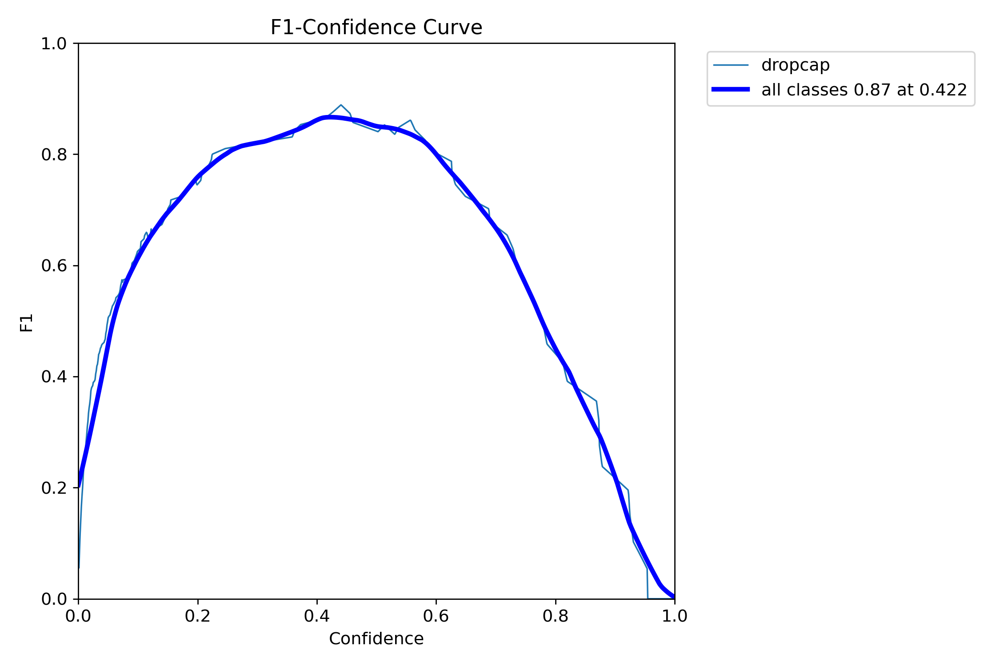

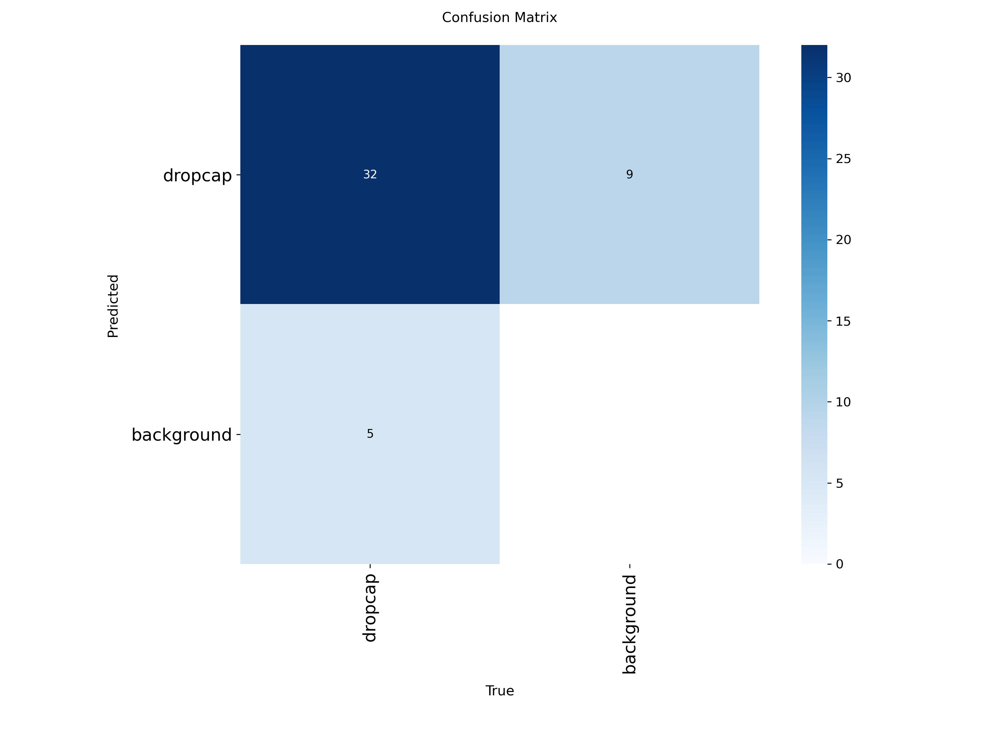

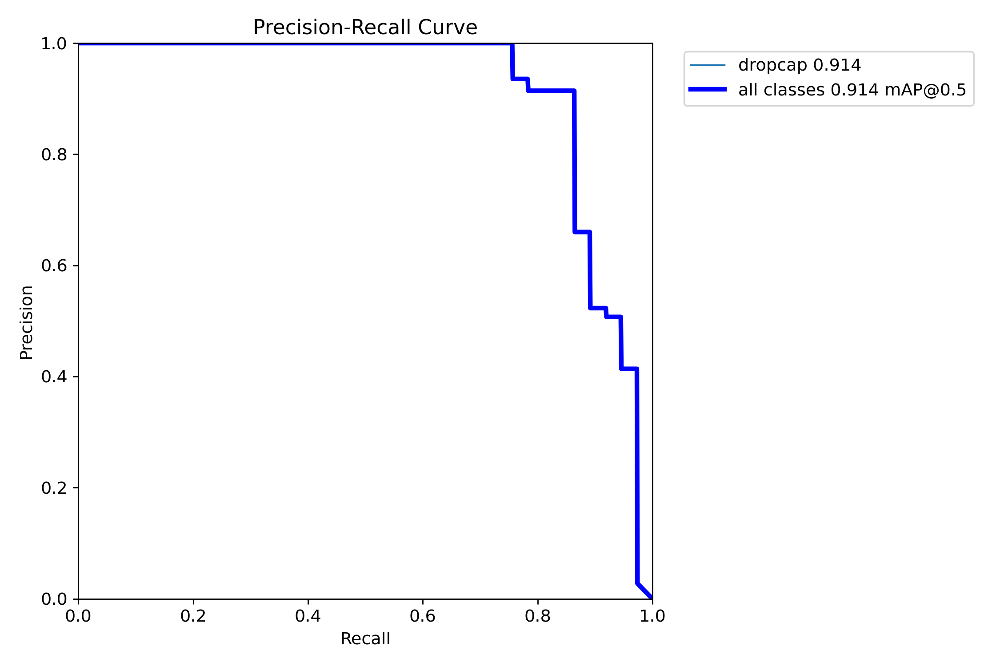

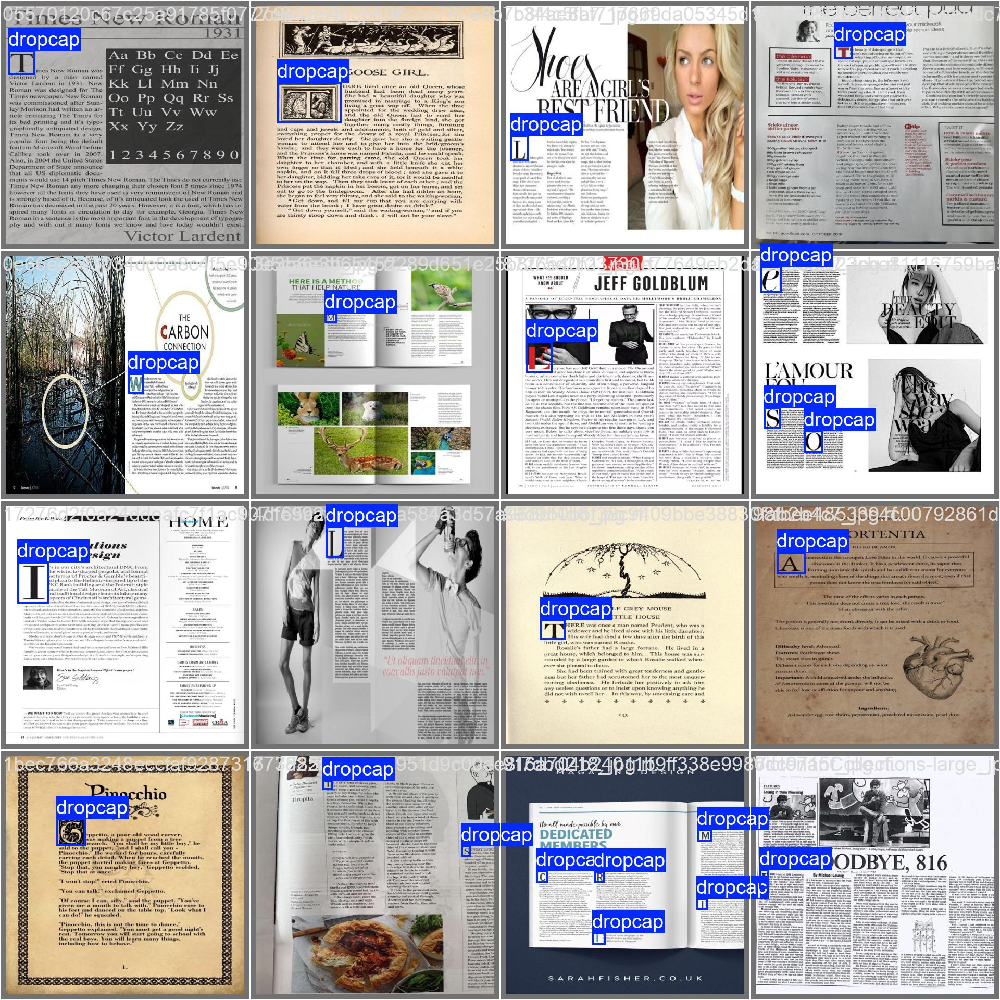

In [36]:
from IPython.display import Image, display

display(Image(filename='runs/detect/val2/F1_curve.png'))
display(Image(filename='runs/detect/val2/confusion_matrix.png'))
display(Image(filename='runs/detect/val2/PR_curve.png'))
display(Image(filename='runs/detect/val2/val_batch0_labels.jpg'))



image 1/1 /content/1644721472440-2.jpeg: 736x896 1 dropcap, 40.2ms
Speed: 4.7ms preprocess, 40.2ms inference, 1.6ms postprocess per image at shape (1, 3, 736, 896)


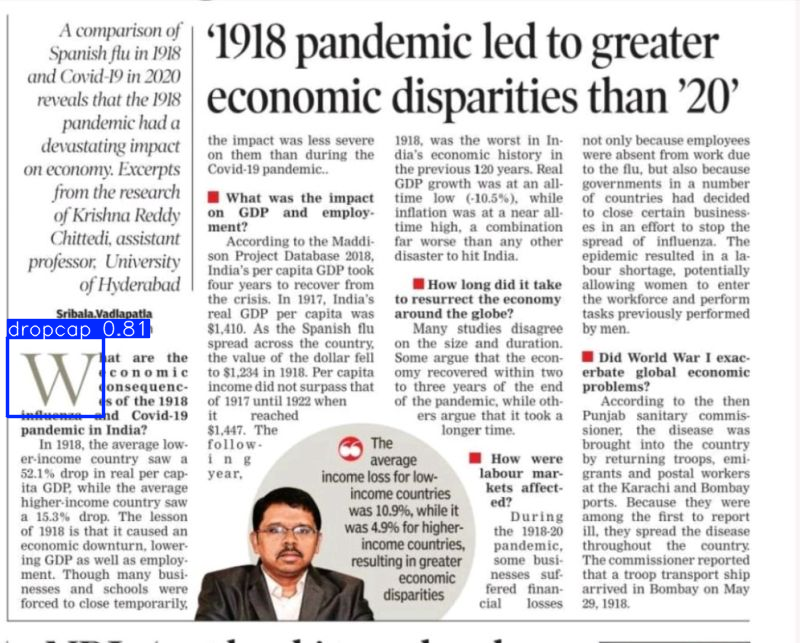

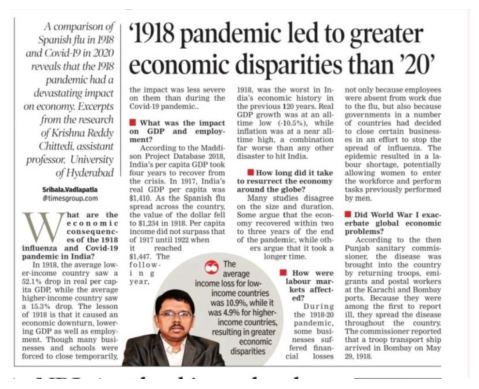

In [54]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/1644721472440-2.jpeg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


Showing: 14fa6dbb0d433ec955218c9764e80991_jpg.rf.041a2f5e48b254c094d43cc4fd53ba4e.jpg

image 1/1 /content/dropcap_300/test/images/14fa6dbb0d433ec955218c9764e80991_jpg.rf.041a2f5e48b254c094d43cc4fd53ba4e.jpg: 896x896 1 dropcap, 26.0ms
Speed: 6.5ms preprocess, 26.0ms inference, 1.6ms postprocess per image at shape (1, 3, 896, 896)


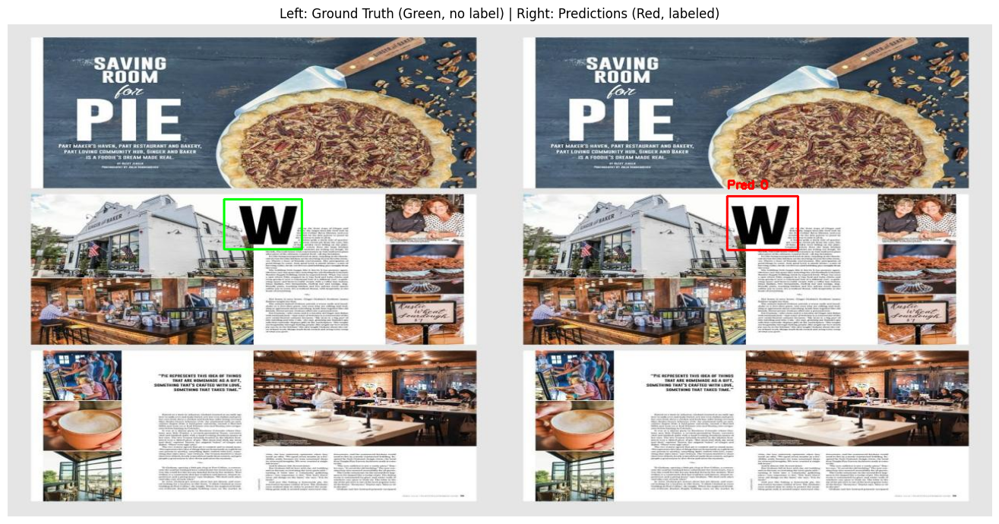


Showing: 193996c482e46087687a289e1dc7219c_jpg.rf.3d1e6c286656408e984984c94159b03d.jpg

image 1/1 /content/dropcap_300/test/images/193996c482e46087687a289e1dc7219c_jpg.rf.3d1e6c286656408e984984c94159b03d.jpg: 896x896 1 dropcap, 26.0ms
Speed: 7.4ms preprocess, 26.0ms inference, 1.9ms postprocess per image at shape (1, 3, 896, 896)


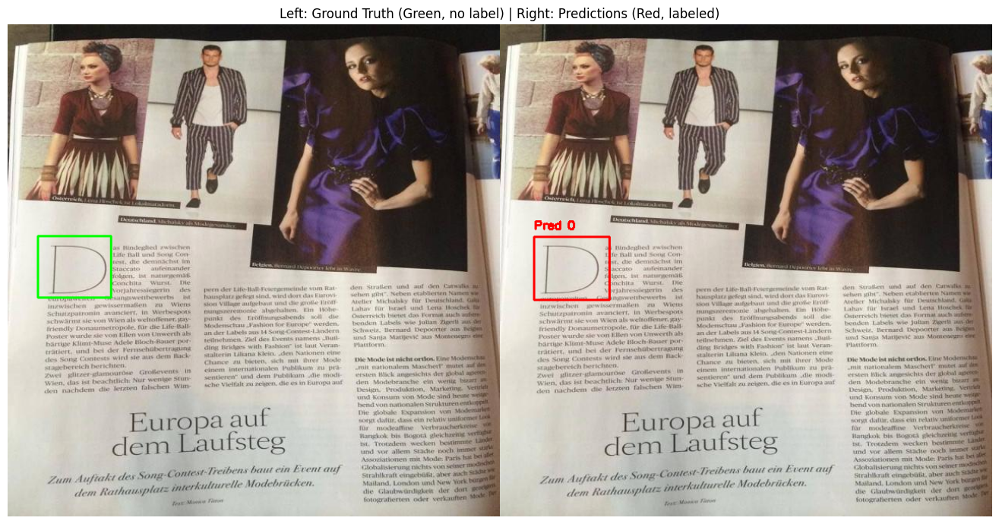


Showing: 2769f101843bbb1b88513bbac60d4f67_jpg.rf.7b2d581b1af6156b52ee886b236b1710.jpg

image 1/1 /content/dropcap_300/test/images/2769f101843bbb1b88513bbac60d4f67_jpg.rf.7b2d581b1af6156b52ee886b236b1710.jpg: 896x896 1 dropcap, 26.0ms
Speed: 12.1ms preprocess, 26.0ms inference, 1.9ms postprocess per image at shape (1, 3, 896, 896)


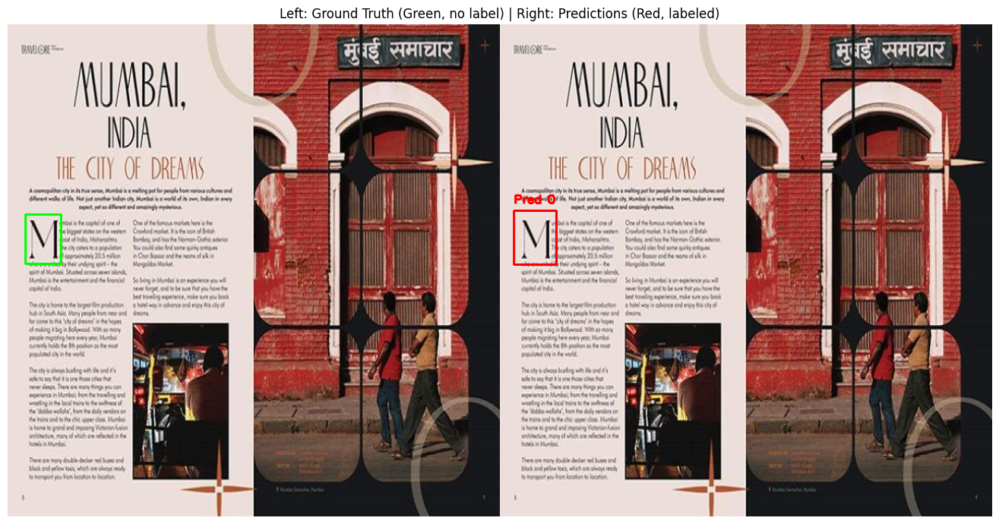


Showing: 4419e418fb3dfbb8d2cbea13e2877140_jpg.rf.ce820c61518cb2718d737e76abc67658.jpg

image 1/1 /content/dropcap_300/test/images/4419e418fb3dfbb8d2cbea13e2877140_jpg.rf.ce820c61518cb2718d737e76abc67658.jpg: 896x896 (no detections), 26.4ms
Speed: 7.7ms preprocess, 26.4ms inference, 1.1ms postprocess per image at shape (1, 3, 896, 896)


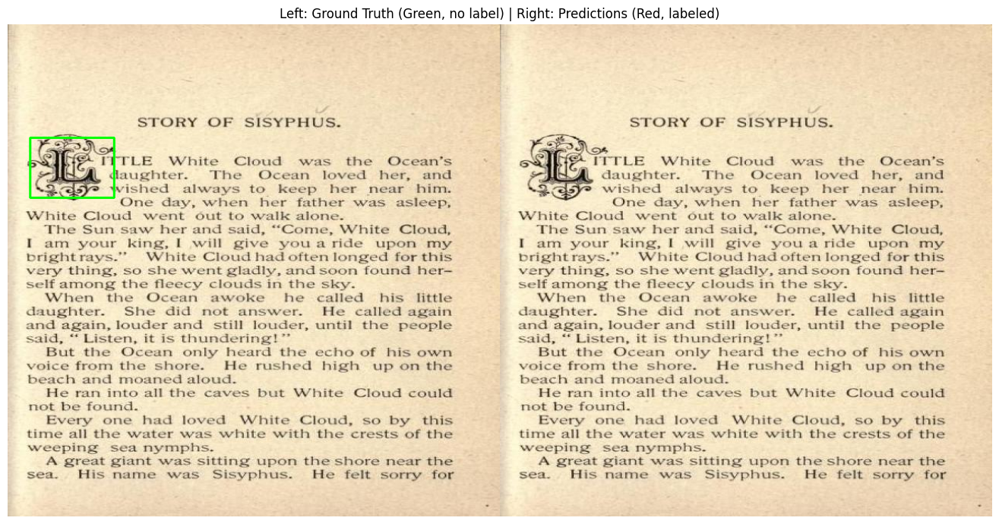


Showing: 58dbafa0f26b25f0fa83c99394f1fa66_jpg.rf.948634f90b401a29085d84cca904d331.jpg

image 1/1 /content/dropcap_300/test/images/58dbafa0f26b25f0fa83c99394f1fa66_jpg.rf.948634f90b401a29085d84cca904d331.jpg: 896x896 2 dropcaps, 26.0ms
Speed: 12.0ms preprocess, 26.0ms inference, 4.3ms postprocess per image at shape (1, 3, 896, 896)


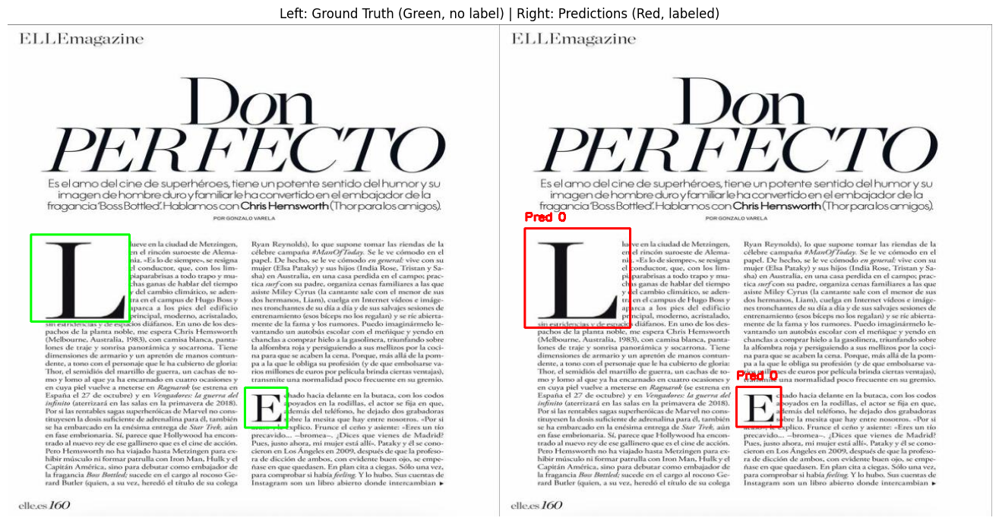


Showing: 7b336db90e4241e823d21aae86cfc206_jpg.rf.92de4c7fcbce4749260253b4d744cd04.jpg

image 1/1 /content/dropcap_300/test/images/7b336db90e4241e823d21aae86cfc206_jpg.rf.92de4c7fcbce4749260253b4d744cd04.jpg: 896x896 1 dropcap, 26.1ms
Speed: 7.9ms preprocess, 26.1ms inference, 1.9ms postprocess per image at shape (1, 3, 896, 896)


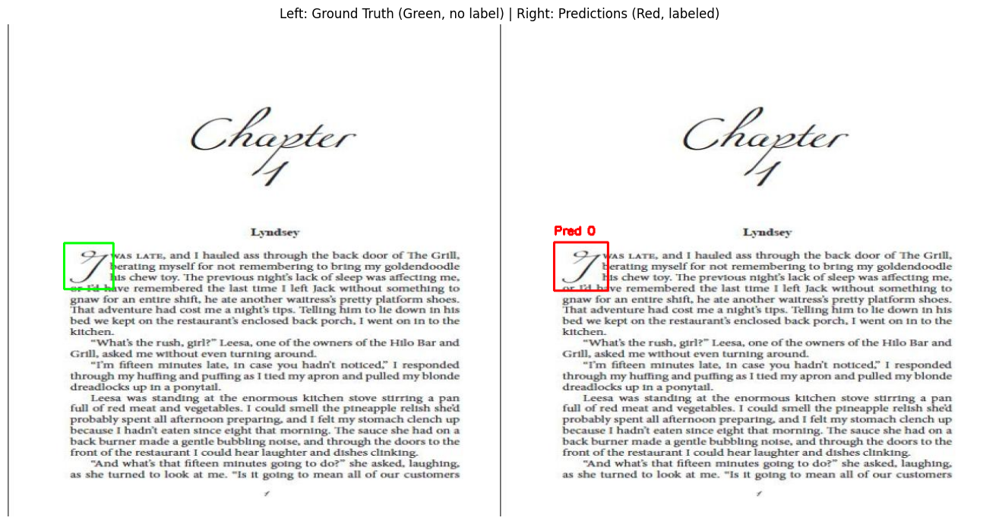


Showing: 8974c392a2042db0ea71cc1f2bba2784_jpg.rf.12516fef0dbf5924def9cbd5d56b7a96.jpg

image 1/1 /content/dropcap_300/test/images/8974c392a2042db0ea71cc1f2bba2784_jpg.rf.12516fef0dbf5924def9cbd5d56b7a96.jpg: 896x896 1 dropcap, 26.4ms
Speed: 8.3ms preprocess, 26.4ms inference, 2.3ms postprocess per image at shape (1, 3, 896, 896)


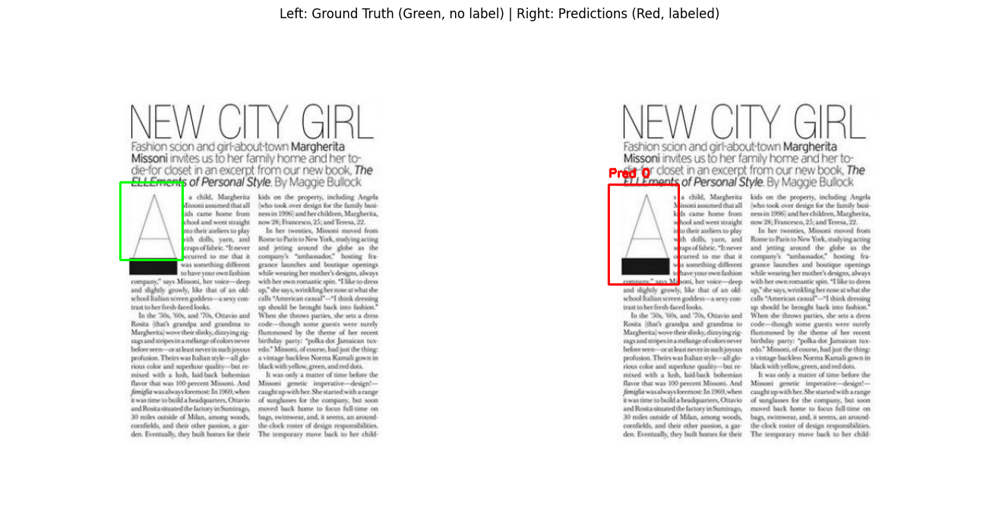


Showing: b707946ad387f8068330da5a9d910848_jpg.rf.1273c567f9451d6094c869750586438e.jpg

image 1/1 /content/dropcap_300/test/images/b707946ad387f8068330da5a9d910848_jpg.rf.1273c567f9451d6094c869750586438e.jpg: 896x896 2 dropcaps, 26.0ms
Speed: 11.4ms preprocess, 26.0ms inference, 2.0ms postprocess per image at shape (1, 3, 896, 896)


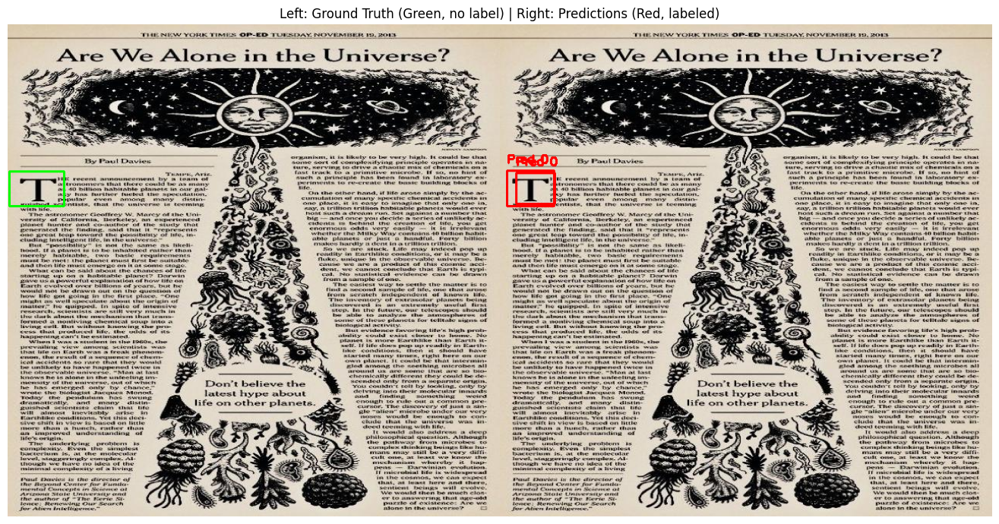


Showing: c3e883034911ade68ba2a0a66be5f597_jpg.rf.032a95db97e640407d0287e9e780b927.jpg

image 1/1 /content/dropcap_300/test/images/c3e883034911ade68ba2a0a66be5f597_jpg.rf.032a95db97e640407d0287e9e780b927.jpg: 896x896 1 dropcap, 26.1ms
Speed: 7.4ms preprocess, 26.1ms inference, 2.2ms postprocess per image at shape (1, 3, 896, 896)


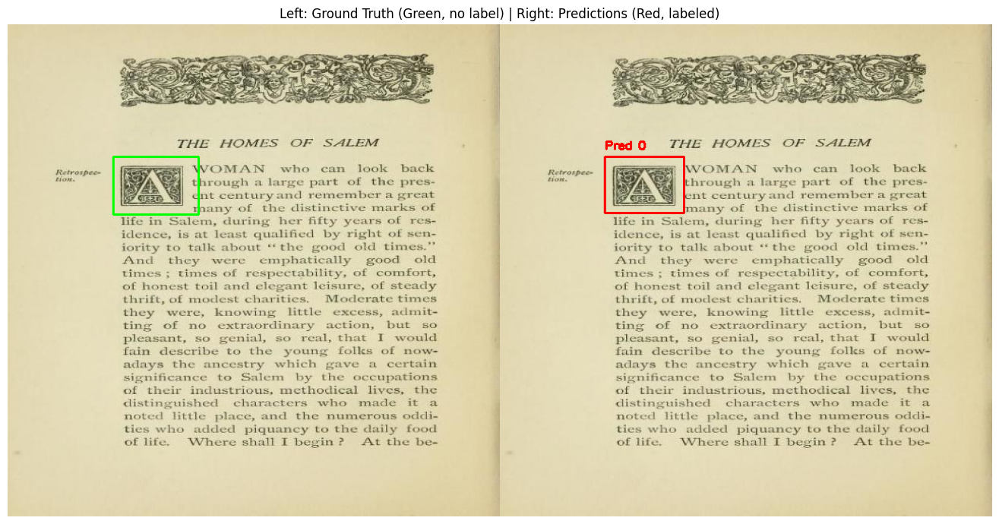


Showing: c95e587ec849db27b3e294307f7d196a_jpg.rf.94f65ee1a985151c8579a65a56146fd2.jpg

image 1/1 /content/dropcap_300/test/images/c95e587ec849db27b3e294307f7d196a_jpg.rf.94f65ee1a985151c8579a65a56146fd2.jpg: 896x896 1 dropcap, 26.0ms
Speed: 7.6ms preprocess, 26.0ms inference, 2.0ms postprocess per image at shape (1, 3, 896, 896)


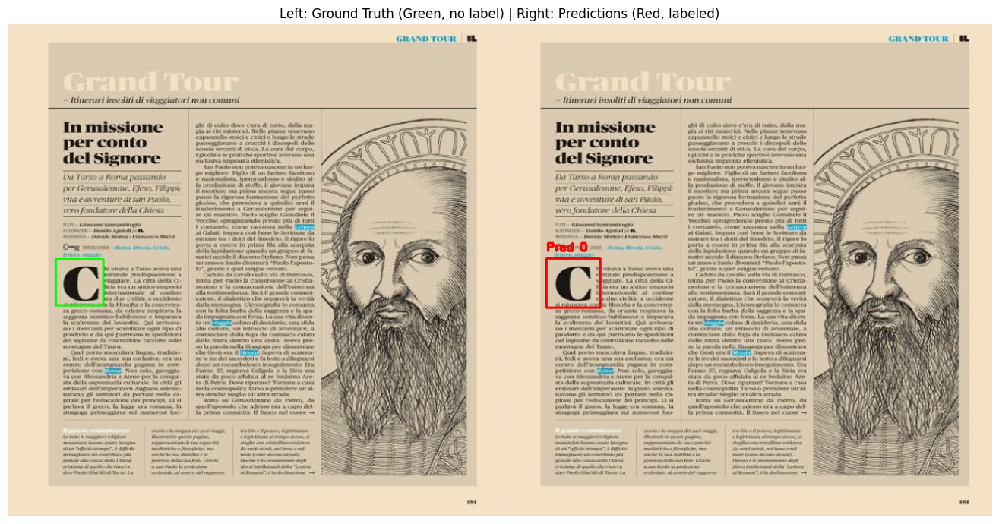


Showing: cedfbd45c4d9bf038035d19c22bda116_jpg.rf.aacf1d57f21437121fe41ba9f49addc5.jpg

image 1/1 /content/dropcap_300/test/images/cedfbd45c4d9bf038035d19c22bda116_jpg.rf.aacf1d57f21437121fe41ba9f49addc5.jpg: 896x896 2 dropcaps, 27.8ms
Speed: 7.9ms preprocess, 27.8ms inference, 1.9ms postprocess per image at shape (1, 3, 896, 896)


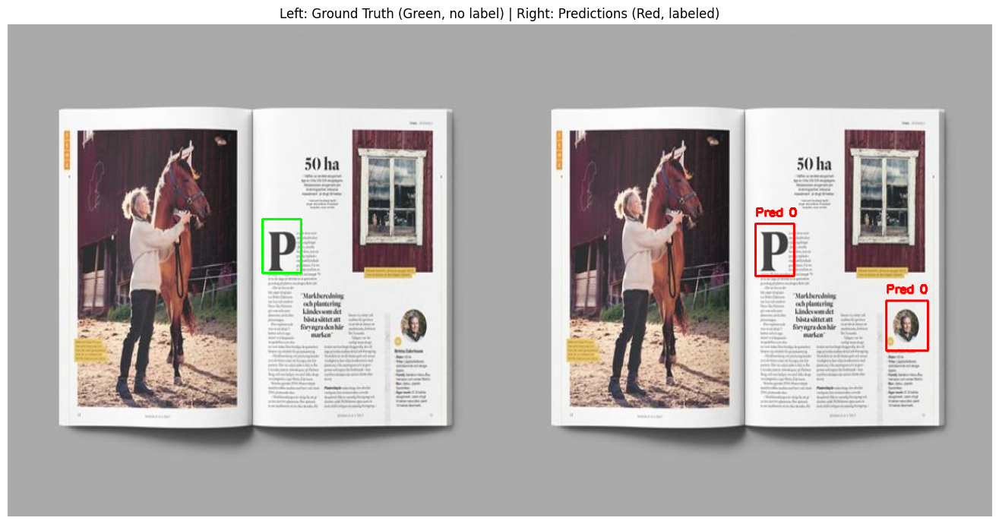


Showing: d436924174b3c87954b3b4af146a4073_jpg.rf.033f2c58f19d8f6ed2f1fea3ebc2e615.jpg

image 1/1 /content/dropcap_300/test/images/d436924174b3c87954b3b4af146a4073_jpg.rf.033f2c58f19d8f6ed2f1fea3ebc2e615.jpg: 896x896 1 dropcap, 26.0ms
Speed: 8.1ms preprocess, 26.0ms inference, 2.0ms postprocess per image at shape (1, 3, 896, 896)


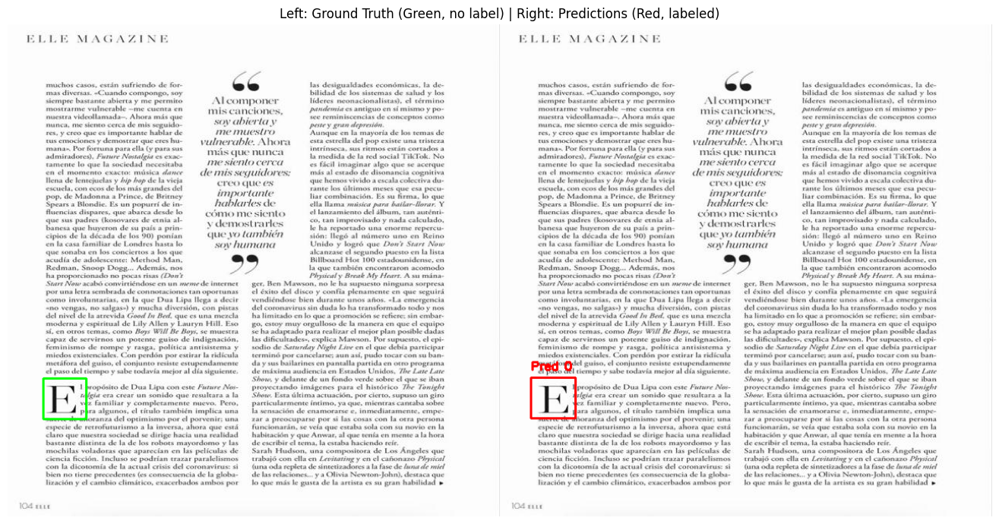


Showing: dd29536b117bcb83f919c8414275da31_jpg.rf.9fe2aeeb570c0f4c3fd514427e5db6fd.jpg

image 1/1 /content/dropcap_300/test/images/dd29536b117bcb83f919c8414275da31_jpg.rf.9fe2aeeb570c0f4c3fd514427e5db6fd.jpg: 896x896 3 dropcaps, 26.0ms
Speed: 7.5ms preprocess, 26.0ms inference, 4.5ms postprocess per image at shape (1, 3, 896, 896)


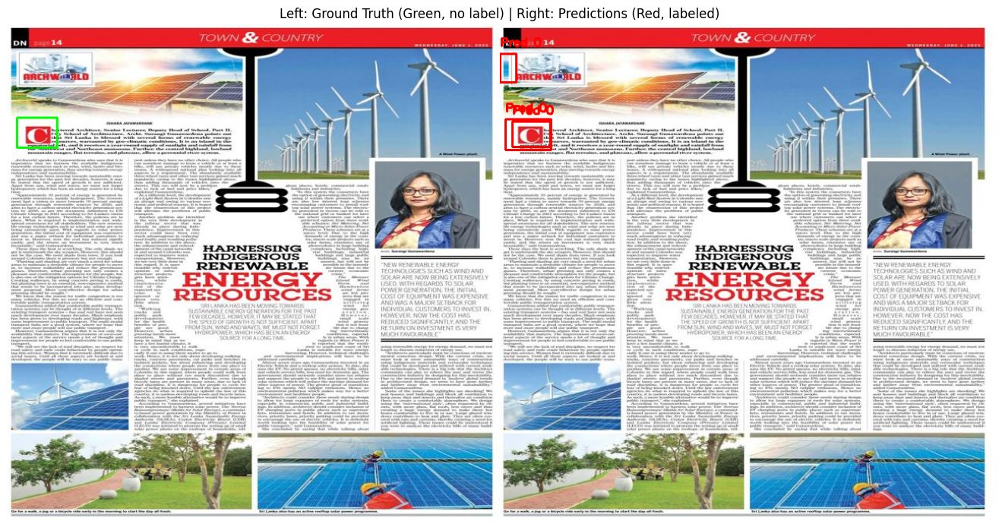


Showing: dropcap07_jpeg.rf.4d8e8822be211517f07051b4051b3987.jpg

image 1/1 /content/dropcap_300/test/images/dropcap07_jpeg.rf.4d8e8822be211517f07051b4051b3987.jpg: 896x896 3 dropcaps, 26.0ms
Speed: 8.1ms preprocess, 26.0ms inference, 2.1ms postprocess per image at shape (1, 3, 896, 896)


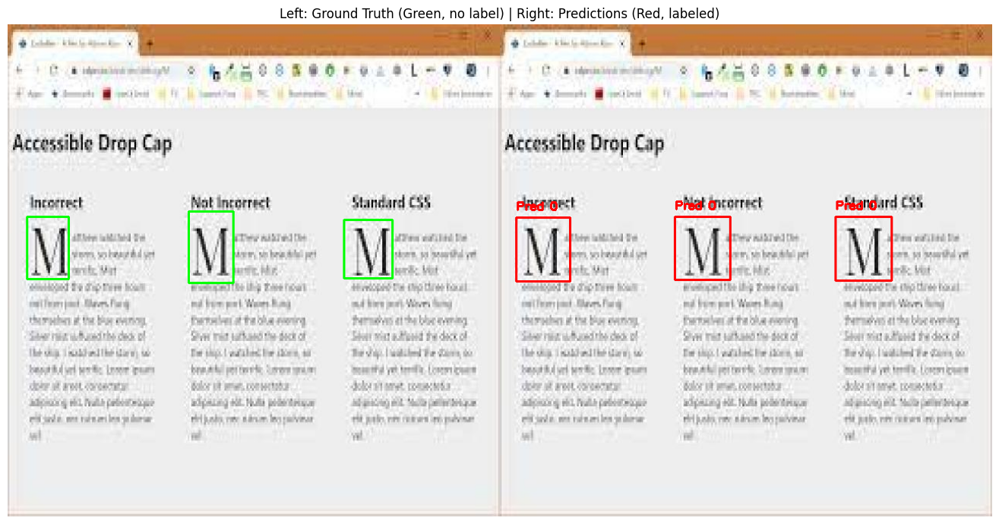


Showing: f290de2f55fd8c54a4e3f6b363a9fc29_jpg.rf.72312bc389c6b6188a60bb3088211671.jpg

image 1/1 /content/dropcap_300/test/images/f290de2f55fd8c54a4e3f6b363a9fc29_jpg.rf.72312bc389c6b6188a60bb3088211671.jpg: 896x896 1 dropcap, 26.0ms
Speed: 10.9ms preprocess, 26.0ms inference, 4.5ms postprocess per image at shape (1, 3, 896, 896)


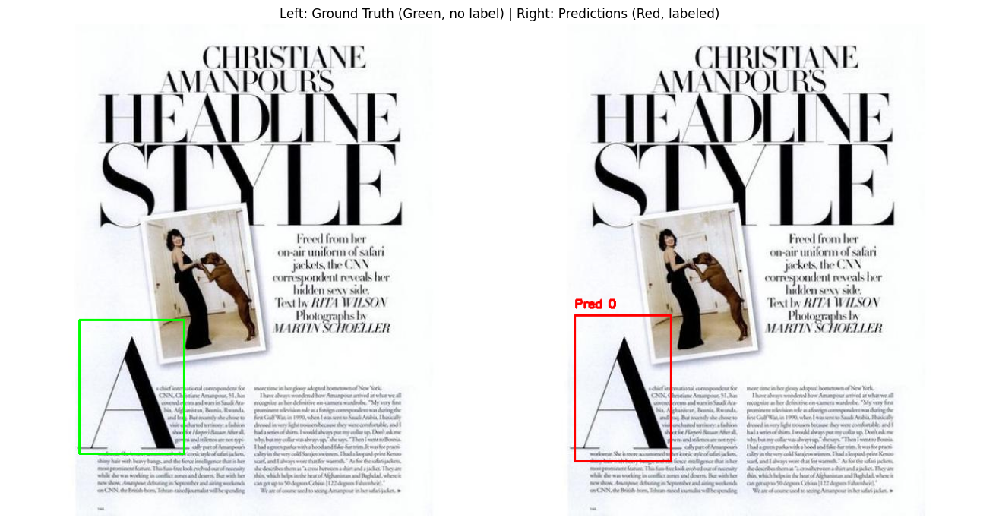

In [40]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Load YOLOv8 model
model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

def load_labels(label_path):
    boxes = []
    with open(label_path, 'r') as f:
        for line in f.readlines():
            cls, x_c, y_c, w, h = map(float, line.strip().split())
            boxes.append((int(cls), x_c, y_c, w, h))
    return boxes

def draw_boxes(image, boxes, color, label_prefix="", show_label=True):
    h, w = image.shape[:2]
    for (cls, x_c, y_c, bw, bh) in boxes:
        x1 = int((x_c - bw / 2) * w)
        y1 = int((y_c - bh / 2) * h)
        x2 = int((x_c + bw / 2) * w)
        y2 = int((y_c + bh / 2) * h)
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        if show_label:
            cv2.putText(image, f"{label_prefix} {cls}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return image

def visualize_gt_and_prediction(image_path, label_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img_h, img_w = img.shape[:2]

    # Ground Truth (no label text)
    gt_boxes = load_labels(label_path)
    img_gt = draw_boxes(img.copy(), gt_boxes, color=(0, 255, 0), show_label=False)

    # Predictions
    results = model(image_path)
    pred_boxes = []
    for box in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = box
        w = x2 - x1
        h = y2 - y1
        x_c = (x1 + x2) / 2
        y_c = (y1 + y2) / 2
        pred_boxes.append((
            int(cls),
            x_c / img_w,
            y_c / img_h,
            w / img_w,
            h / img_h
        ))

    img_pred = draw_boxes(img.copy(), pred_boxes, color=(255, 0, 0), label_prefix='Pred', show_label=True)

    # Combine side by side
    combined = cv2.hconcat([img_gt, img_pred])

    # Show using matplotlib
    plt.figure(figsize=(14, 7))
    plt.imshow(combined)
    plt.title('Left: Ground Truth (Green, no label) | Right: Predictions (Red, labeled)')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# === Run on All Test Images ===
image_dir = '/content/dropcap_300/test/images'
label_dir = '/content/dropcap_300/test/labels'

for img_file in sorted(os.listdir(image_dir)):
    if img_file.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_dir, img_file)
        label_path = os.path.join(label_dir, os.path.splitext(img_file)[0] + '.txt')
        if os.path.exists(label_path):
            print(f"\nShowing: {img_file}")
            visualize_gt_and_prediction(image_path, label_path)


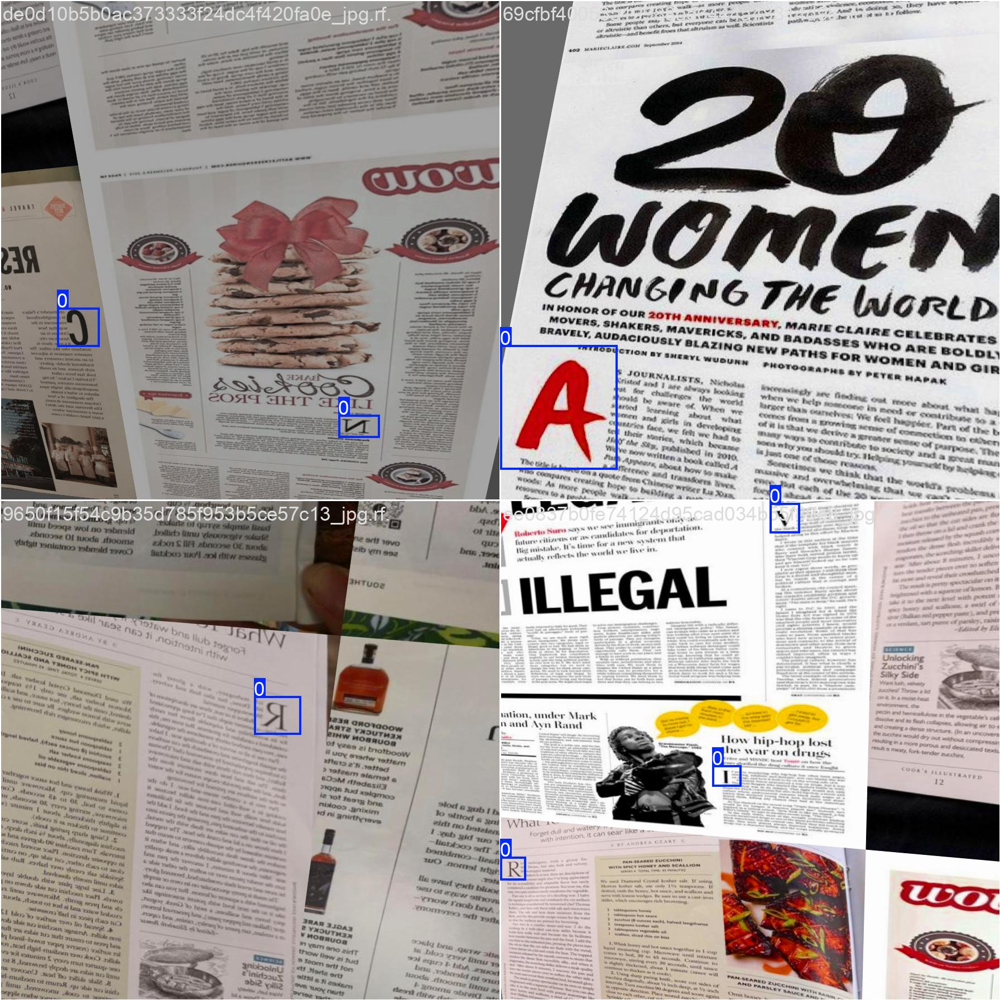

In [52]:
from IPython.display import Image, display
display(Image(filename='/content/dropcap-runs/dropcap-v2/train_batch2.jpg'))




image 1/1 /content/368bc64e3ac161cffefad1f4b8f34560.jpg: 896x672 1 dropcap, 42.8ms
Speed: 5.4ms preprocess, 42.8ms inference, 2.4ms postprocess per image at shape (1, 3, 896, 672)


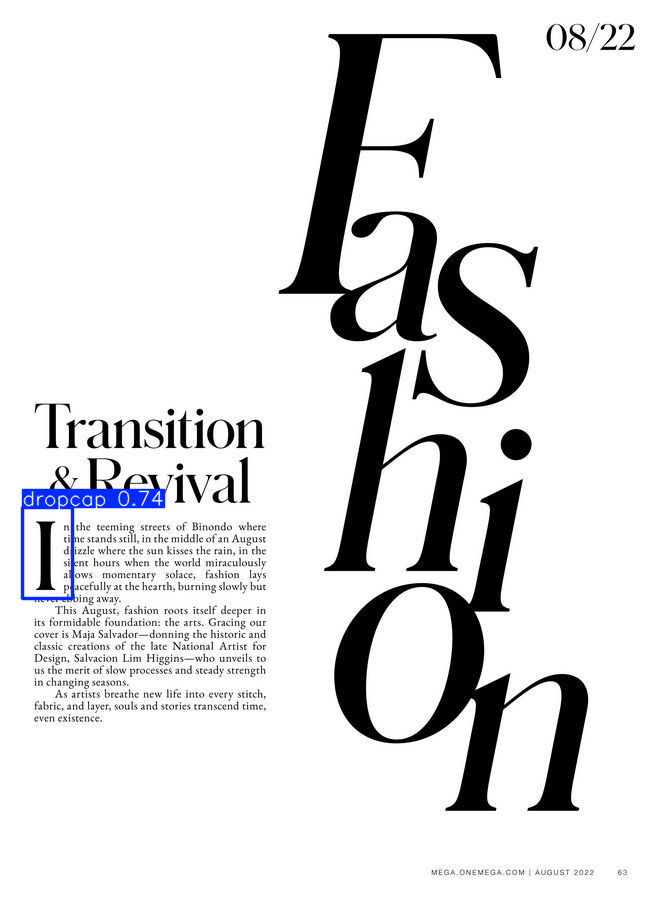

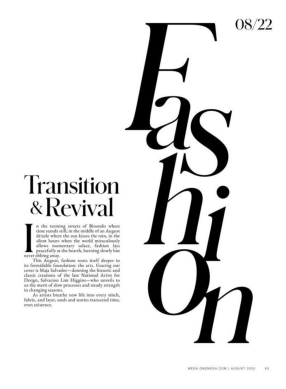

In [43]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('/content/dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/368bc64e3ac161cffefad1f4b8f34560.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/3875d32aca96feaaa01c9f4401827fcf.jpg: 896x704 1 dropcap, 40.1ms
Speed: 4.8ms preprocess, 40.1ms inference, 1.6ms postprocess per image at shape (1, 3, 896, 704)


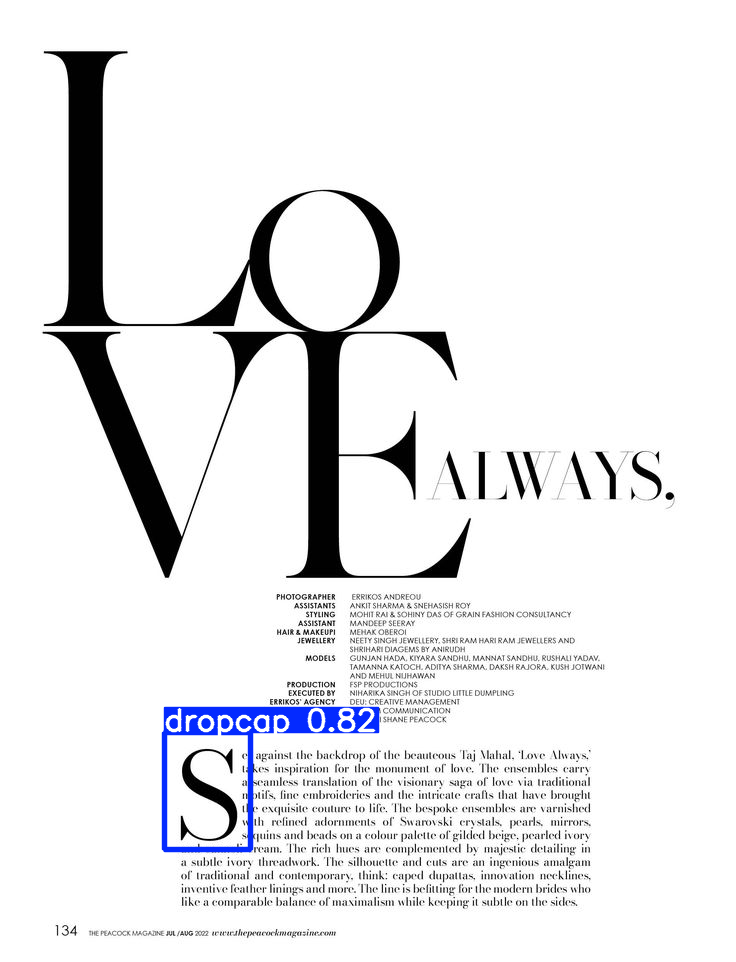

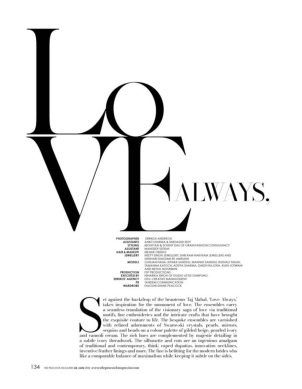

In [44]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2


model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/3875d32aca96feaaa01c9f4401827fcf.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()

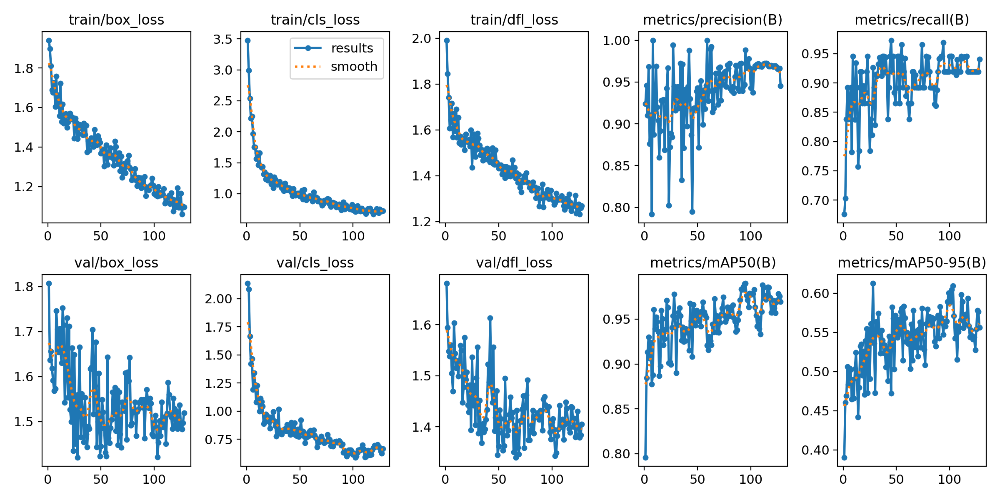

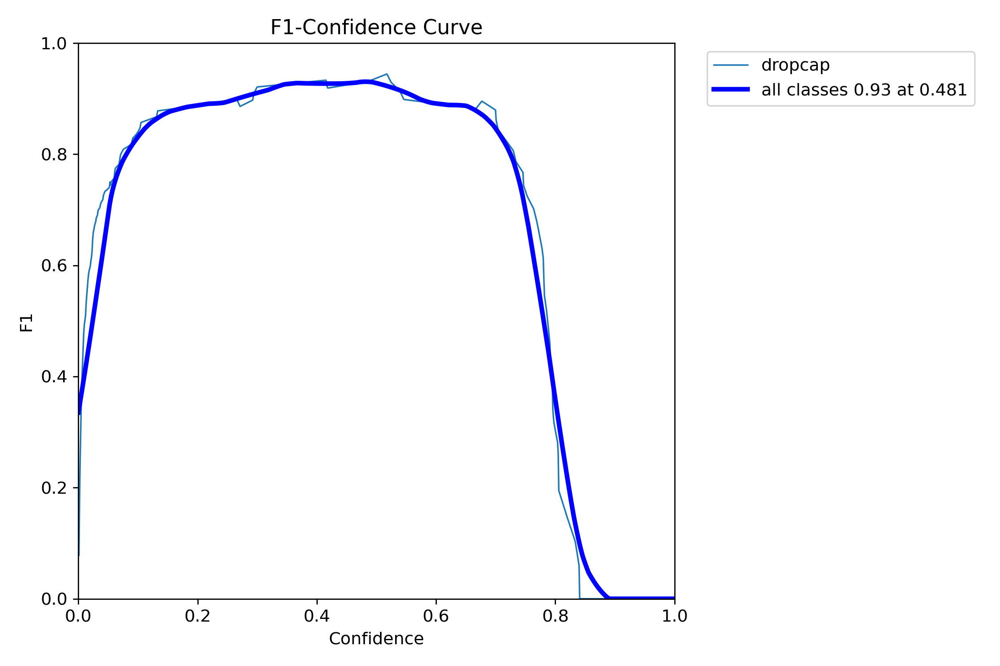

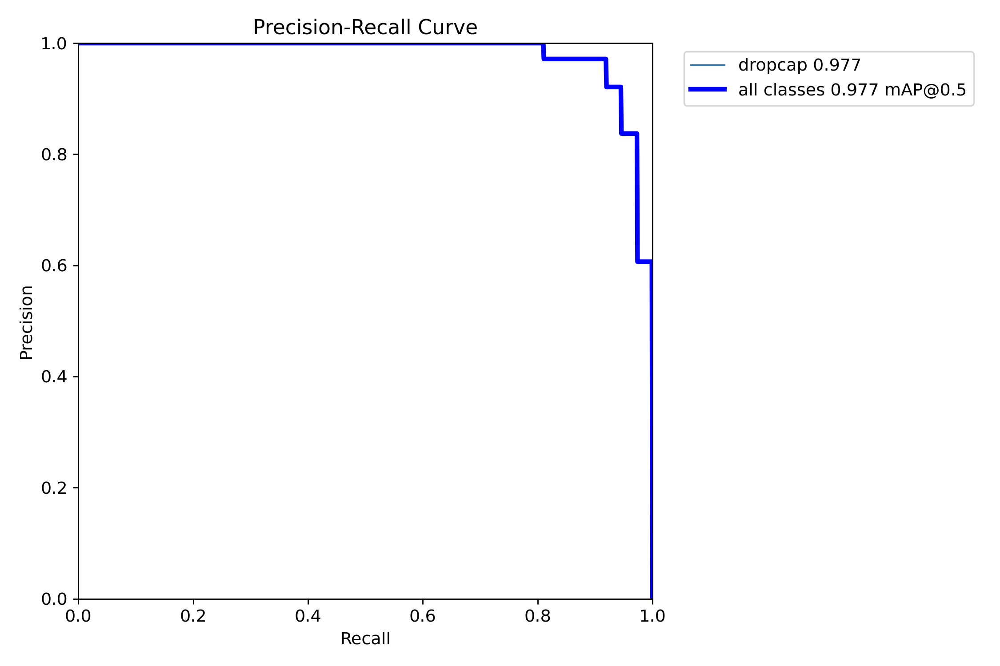

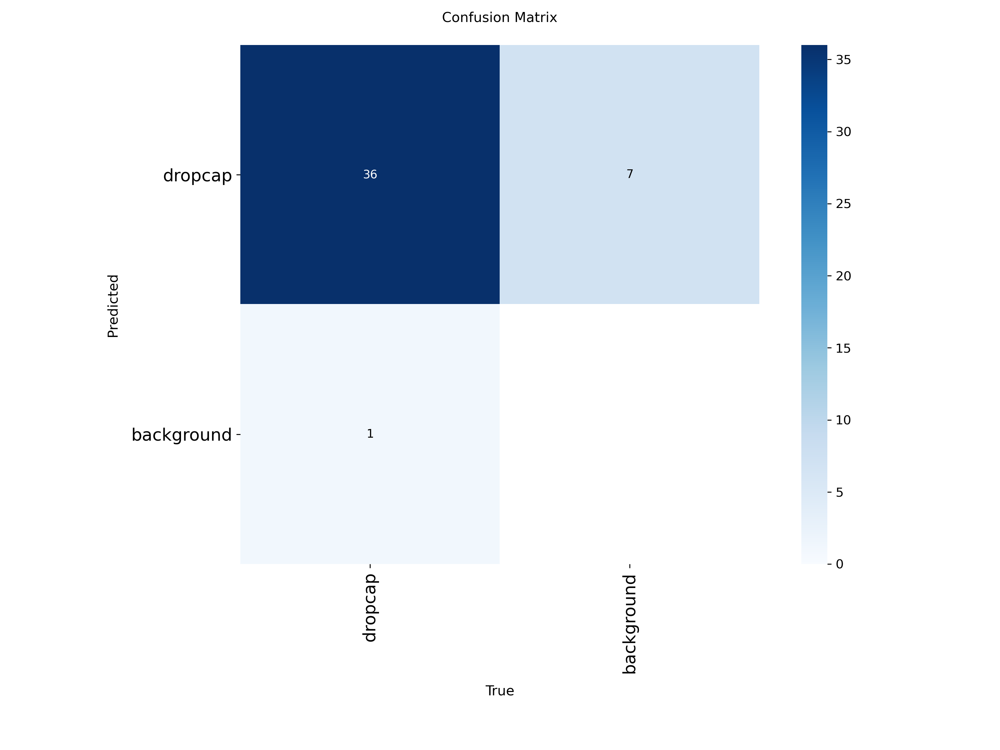

In [45]:
from IPython.display import Image, display

display(Image(filename='/content/dropcap-runs/dropcap-v2/results.png'))
display(Image(filename='/content/dropcap-runs/dropcap-v2/F1_curve.png'))
display(Image(filename='/content/dropcap-runs/dropcap-v2/PR_curve.png'))
display(Image(filename='/content/dropcap-runs/dropcap-v2/confusion_matrix.png'))


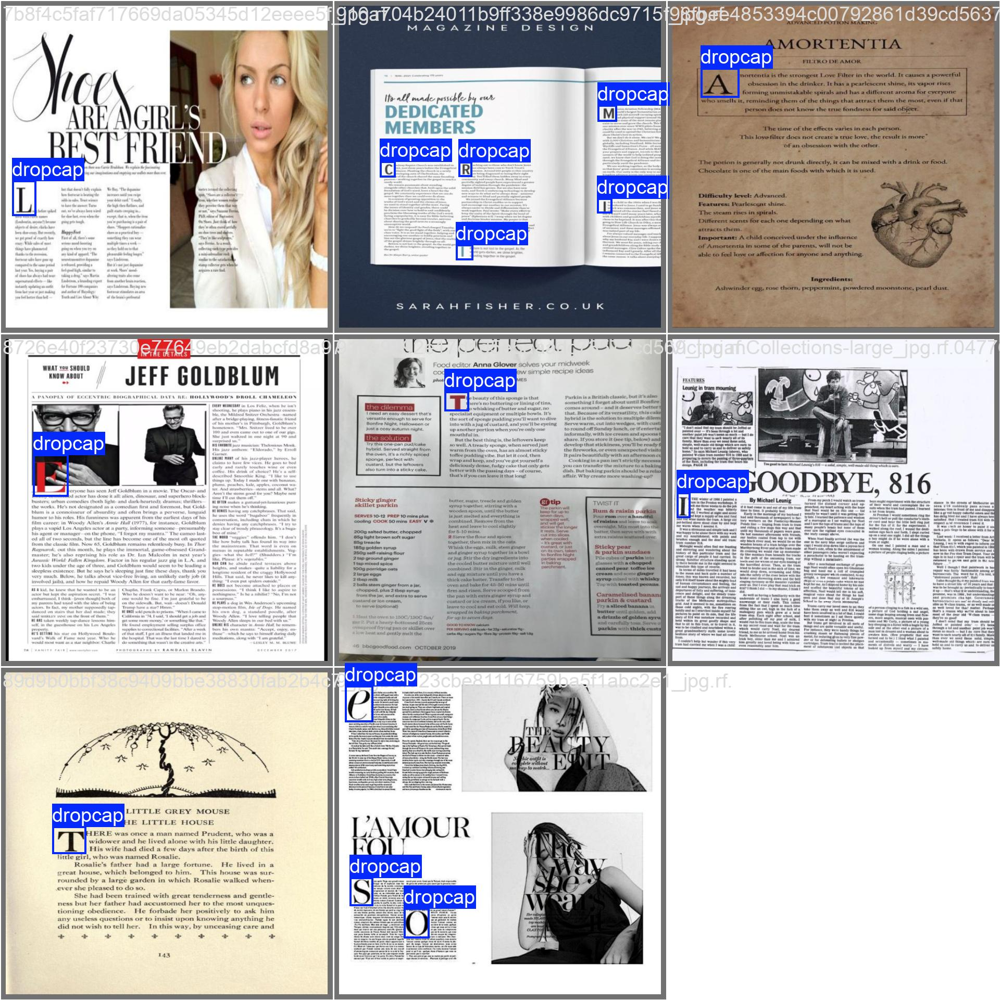

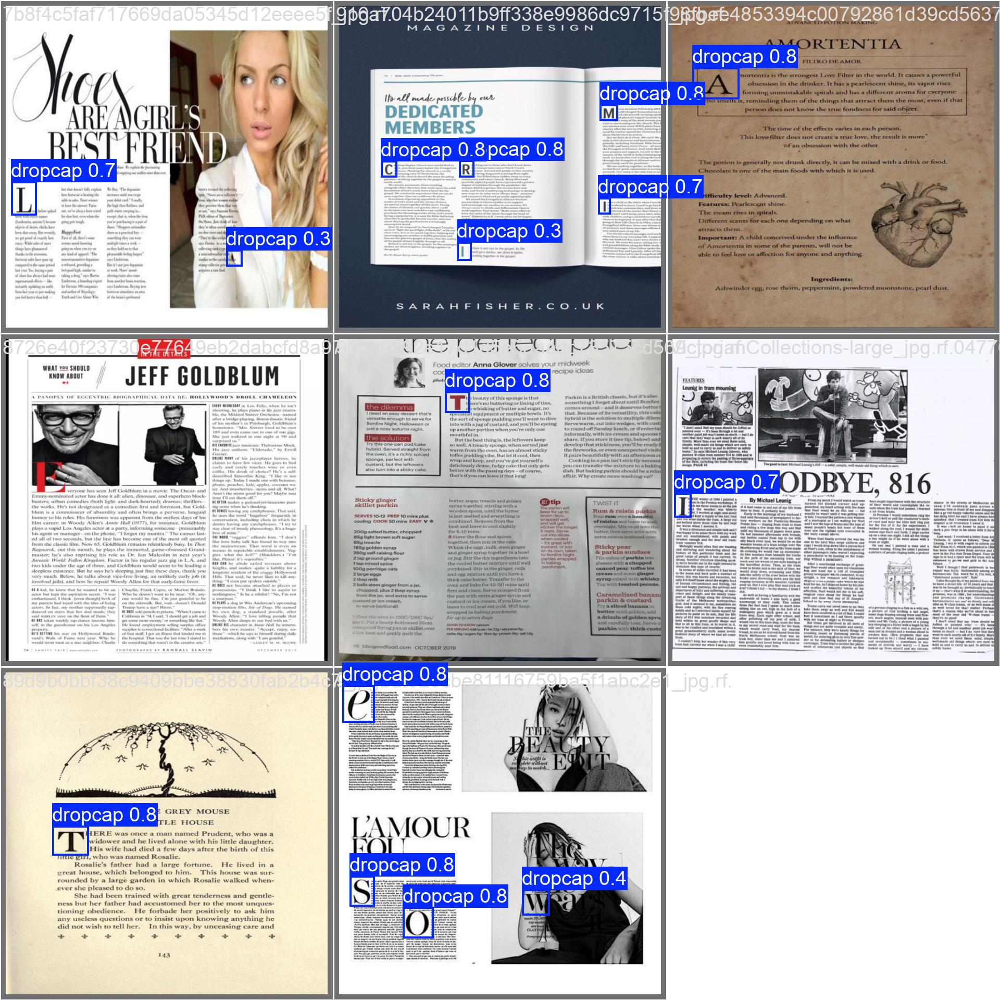

In [46]:
from IPython.display import Image, display

display(Image(filename='/content/dropcap-runs/dropcap-v2/val_batch1_labels.jpg'))
display(Image(filename='/content/dropcap-runs/dropcap-v2/val_batch1_pred.jpg'))



image 1/1 /content/4a01e09f39367705c08e870587983db5.jpg: 896x800 (no detections), 101.4ms
Speed: 10.1ms preprocess, 101.4ms inference, 1.8ms postprocess per image at shape (1, 3, 896, 800)


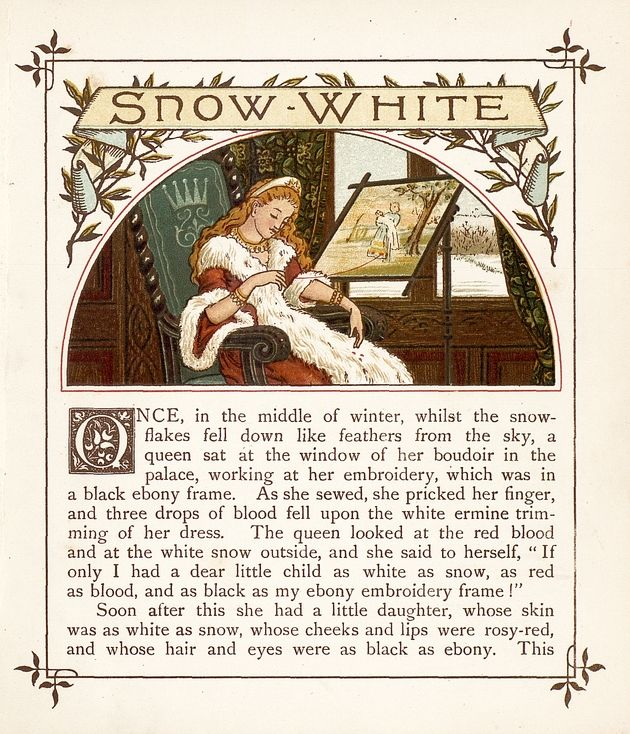

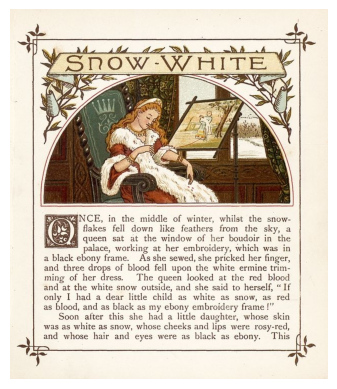

In [ ]:

model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/4a01e09f39367705c08e870587983db5.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/bcf6c933d1e767c48063267dfd91fa42.jpg: 640x480 1 dropcap, 41.9ms
Speed: 2.4ms preprocess, 41.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


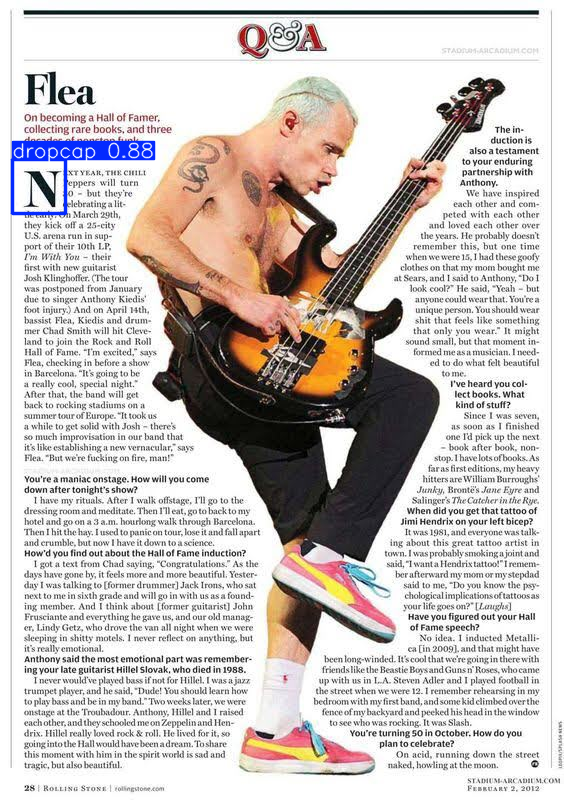

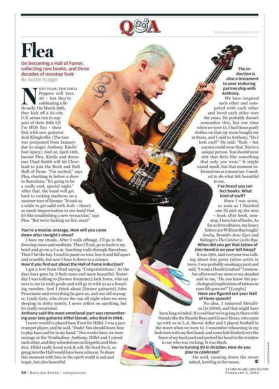

In [48]:
model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')

path = '/content/bcf6c933d1e767c48063267dfd91fa42.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/bcf6c933d1e767c48063267dfd91fa42.jpg: 896x640 1 drop_cap, 21.1ms
Speed: 10.7ms preprocess, 21.1ms inference, 2.2ms postprocess per image at shape (1, 3, 896, 640)


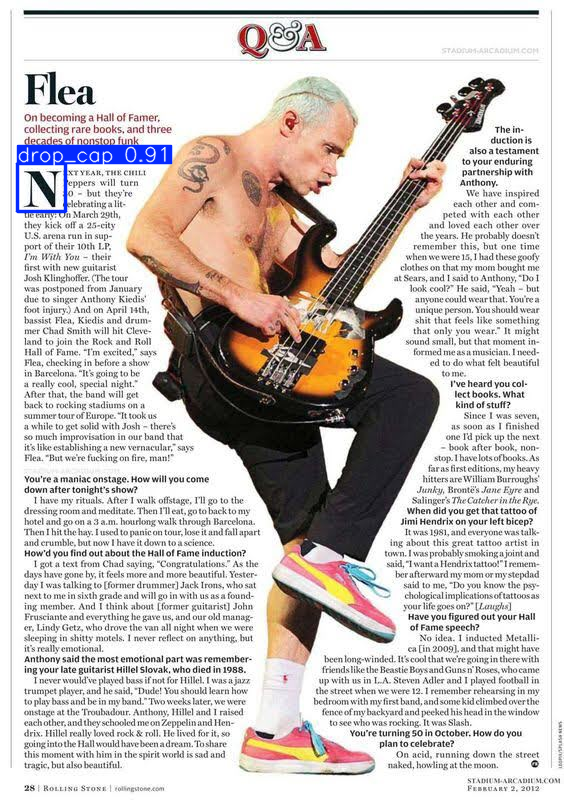

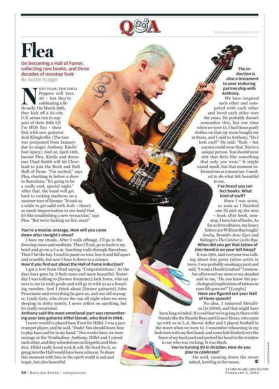

In [ ]:
model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/bcf6c933d1e767c48063267dfd91fa42.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/1824fc47573dbf691d3dcf7ca9b5ea9a.jpg: 896x832 2 dropcaps, 60.7ms
Speed: 7.4ms preprocess, 60.7ms inference, 1.9ms postprocess per image at shape (1, 3, 896, 832)


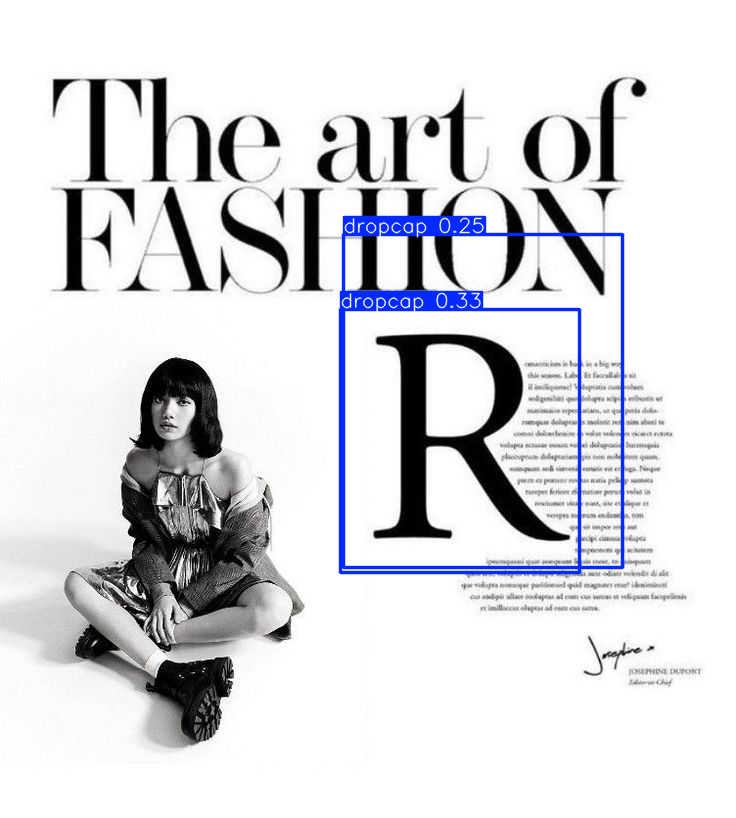

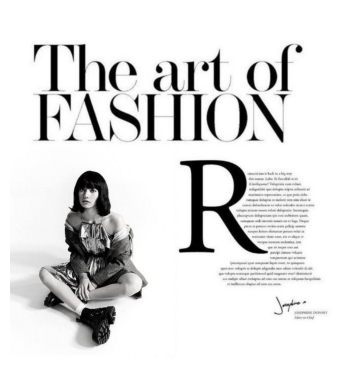

In [49]:
model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')

path = '/content/1824fc47573dbf691d3dcf7ca9b5ea9a.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


image 1/1 /content/1824fc47573dbf691d3dcf7ca9b5ea9a.jpg: 640x576 1 dropcap, 62.3ms
Speed: 9.6ms preprocess, 62.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 576)


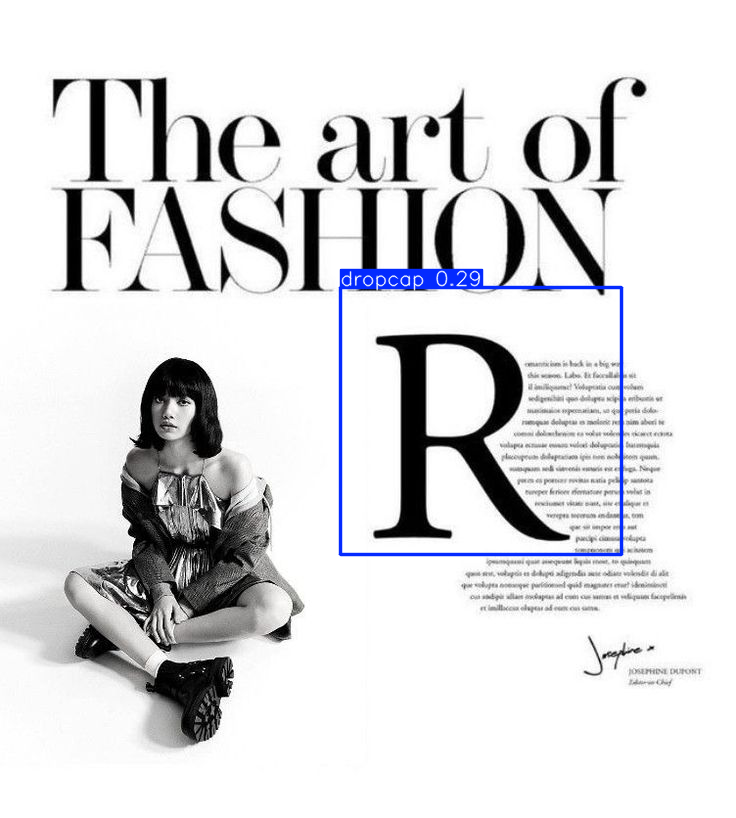

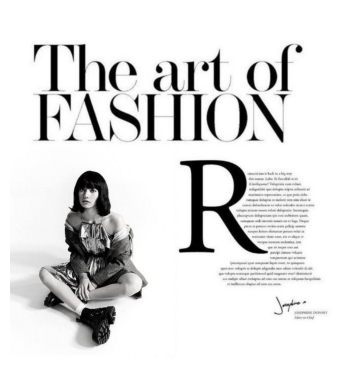

In [50]:
model = YOLO('dropcap-runs/dropcap-yolov8n/weights/best.pt')

path = '/content/1824fc47573dbf691d3dcf7ca9b5ea9a.jpg'


results = model(path)
results[0].show()

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 86.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.8/422.8 kB 41.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 969.6/969.6 kB 64.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 292.9/292.9 kB 31.6 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import cv2
import easyocr

model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')
path = '/content/bcf6c933d1e767c48063267dfd91fa42.jpg'
results = model(path)


image 1/1 /content/bcf6c933d1e767c48063267dfd91fa42.jpg: 896x640 1 drop_cap, 21.0ms
Speed: 4.9ms preprocess, 21.0ms inference, 1.7ms postprocess per image at shape (1, 3, 896, 640)



image 1/1 /content/bcf6c933d1e767c48063267dfd91fa42.jpg: 896x640 1 drop_cap, 21.0ms
Speed: 4.1ms preprocess, 21.0ms inference, 1.6ms postprocess per image at shape (1, 3, 896, 640)
{'box_index': 1, 'bounding_box': [17, 163, 65, 211], 'text': 'N', 'confidence': np.float64(0.99)}


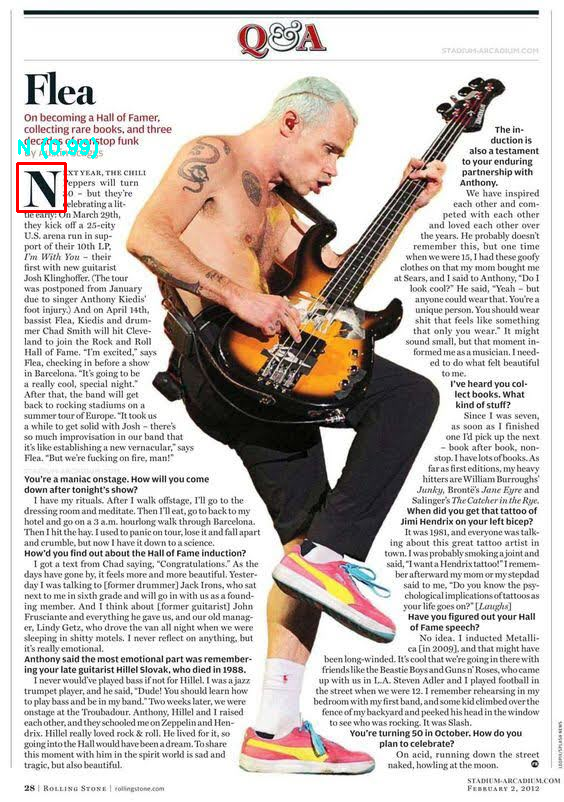

In [ ]:
import cv2
import easyocr
from ultralytics import YOLO
from google.colab.patches import cv2_imshow

model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')
img_path = '/content/bcf6c933d1e767c48063267dfd91fa42.jpg'
img = cv2.imread(img_path)

# Run inference
results = model(img_path)
boxes = results[0].boxes.xyxy.cpu().numpy()  # xyxy: [x1, y1, x2, y2]

# Initialize EasyOCR reader
reader = easyocr.Reader(['en'], gpu=True)
ocr_outputs = []

for i, box in enumerate(boxes):
    x1, y1, x2, y2 = map(int, box)
    cropped_img = img[y1:y2, x1:x2]

    # Convert to grayscale
    gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
    results_ocr = reader.readtext(gray)

    # If OCR detects something, collect the top result
    if results_ocr:
        (bbox, text, confidence) = results_ocr[0]
        ocr_outputs.append({
            'box_index': i + 1,
            'bounding_box': [int(x1), int(y1), int(x2), int(y2)],
            'text': text,
            'confidence': round(confidence, 3)
        })
    else:
        ocr_outputs.append({
            'box_index': i + 1,
            'bounding_box': [int(x1), int(y1), int(x2), int(y2)],
            'text': None,
            'confidence': 0.0
        })

# Print results
for output in ocr_outputs:
    print(output)

# Draw bounding boxes and text on the image
for output in ocr_outputs:
    x1, y1, x2, y2 = output['bounding_box']
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255), 2)
    label = f"{output['text']} ({output['confidence']:.2f})"
    cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,255,0), 2)

cv2_imshow(img)



image 1/1 /content/9b85de63c5f7ff8e9c5de3f211892159.jpg: 896x896 1 drop_cap, 25.8ms
Speed: 4.8ms preprocess, 25.8ms inference, 1.5ms postprocess per image at shape (1, 3, 896, 896)
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'drop_cap'}
obb: None
orig_img: array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 

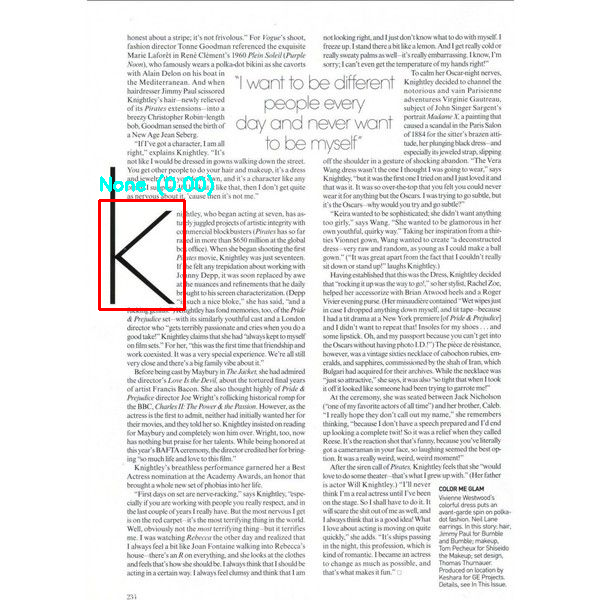

In [ ]:
import cv2
import easyocr
from ultralytics import YOLO
from google.colab.patches import cv2_imshow

model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')
img_path = '/content/9b85de63c5f7ff8e9c5de3f211892159.jpg'
img = cv2.imread(img_path)

# Run inference
results = model(img_path)
boxes = results[0].boxes.xyxy.cpu().numpy()  # xyxy: [x1, y1, x2, y2]

# Initialize EasyOCR reader
reader = easyocr.Reader(['en'], gpu=True)
ocr_outputs = []

for i, box in enumerate(boxes):
    x1, y1, x2, y2 = map(int, box)
    cropped_img = img[y1:y2, x1:x2]

    # Convert to grayscale
    gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
    results_ocr = reader.readtext(gray)

    # If OCR detects something, collect the top result
    if results_ocr:
        (bbox, text, confidence) = results_ocr[0]
        ocr_outputs.append({
            'box_index': i + 1,
            'bounding_box': [int(x1), int(y1), int(x2), int(y2)],
            'text': text,
            'confidence': round(confidence, 3)
        })
    else:
        ocr_outputs.append({
            'box_index': i + 1,
            'bounding_box': [int(x1), int(y1), int(x2), int(y2)],
            'text': None,
            'confidence': 0.0
        })

# Print results
for output in ocr_outputs:
    print(output)

# Draw bounding boxes and text on the image
for output in ocr_outputs:
    x1, y1, x2, y2 = output['bounding_box']
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255), 2)
    label = f"{output['text']} ({output['confidence']:.2f})"
    cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (240,255,0), 2)

cv2_imshow(img)



image 1/1 /content/d3f611a29d88ab64bb6be391cab368b4.jpg: 896x896 3 drop_caps, 25.9ms
Speed: 4.7ms preprocess, 25.9ms inference, 1.7ms postprocess per image at shape (1, 3, 896, 896)
{'box_index': 1, 'bounding_box': [247, 206, 296, 266], 'text': None, 'confidence': 0.0}
{'box_index': 2, 'bounding_box': [369, 189, 404, 246], 'text': '1', 'confidence': np.float64(0.465)}
{'box_index': 3, 'bounding_box': [122, 18, 214, 162], 'text': None, 'confidence': 0.0}


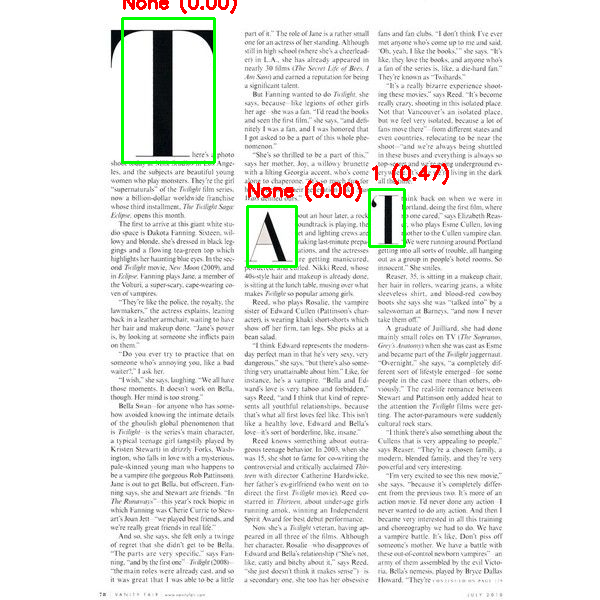

In [ ]:
import cv2
import easyocr
from ultralytics import YOLO
from google.colab.patches import cv2_imshow

model = YOLO('dropcap-runs/dropcap-v2/weights/best.pt')
img_path = '/content/d3f611a29d88ab64bb6be391cab368b4.jpg'
img = cv2.imread(img_path)

# Run inference
results = model(img_path)
boxes = results[0].boxes.xyxy.cpu().numpy()  # xyxy: [x1, y1, x2, y2]

# Initialize EasyOCR reader
reader = easyocr.Reader(['en'], gpu=True)
ocr_outputs = []

for i, box in enumerate(boxes):
    x1, y1, x2, y2 = map(int, box)
    cropped_img = img[y1:y2, x1:x2]

    # Convert to grayscale
    gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
    results_ocr = reader.readtext(gray)

    # If OCR detects something, collect the top result
    if results_ocr:
        (bbox, text, confidence) = results_ocr[0]
        ocr_outputs.append({
            'box_index': i + 1,
            'bounding_box': [int(x1), int(y1), int(x2), int(y2)],
            'text': text,
            'confidence': round(confidence, 3)
        })
    else:
        ocr_outputs.append({
            'box_index': i + 1,
            'bounding_box': [int(x1), int(y1), int(x2), int(y2)],
            'text': None,
            'confidence': 0.0
        })

# Print results
for output in ocr_outputs:
    print(output)

# Draw bounding boxes and text on the image
for output in ocr_outputs:
    x1, y1, x2, y2 = output['bounding_box']
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
    label = f"{output['text']} ({output['confidence']:.2f})"
    cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2)

cv2_imshow(img)
